# Les packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Pour l'apprentissage automatique - classification
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

# Pour NLP
import nltk
nltk.download('punkt')
nltk.download('stopwords')
from nltk.stem import WordNetLemmatizer
from nltk import word_tokenize
from nltk.corpus import stopwords

#pd.options.display.max_rows = 999
import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Importation des données

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Les données
data_nlp = pd.read_csv("/content/drive/MyDrive/Projet_6/Flipkart/flipkart_com-ecommerce_sample_1050.csv")

In [4]:
# Afficher les 5 premières lignes du jeu de données
pd.set_option("display.max_column",15)
data_nlp.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [5]:
# La forme du jeu de données
data_nlp.shape

(1050, 15)

In [6]:
#data_nlp["brand"].nunique()

In [7]:
# Noms des colonnes 
colnames = list(data_nlp.columns)
colnames

['uniq_id',
 'crawl_timestamp',
 'product_url',
 'product_name',
 'product_category_tree',
 'pid',
 'retail_price',
 'discounted_price',
 'image',
 'is_FK_Advantage_product',
 'description',
 'product_rating',
 'overall_rating',
 'brand',
 'product_specifications']

In [8]:
ncol = len(data_nlp.columns) # Nombre de colonnes
print(ncol)

nrow = len(data_nlp.index) # Nombre de lignes
print(nrow)

15
1050


In [9]:
# La sommes des valeurs nulles par colonnes
data_nlp.isnull().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [10]:
# Description statistique sans variables catégorielles
data_nlp.describe().T

,count,mean,std,min,25%,50%,75%,max
retail_price,1049.0,2186.197331,7639.229411,35.0,555.0,999.0,1999.0,201000.0
discounted_price,1049.0,1584.527169,7475.099680,35.0,340.0,600.0,1199.0,201000.0


In [11]:
# Description statistique avec variables catégorielles
data_nlp.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
uniq_id,1050,1050,55b85ea15a1536d46b7190ad6fff8ce7,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
crawl_timestamp,1050,149,2015-12-01 12:40:44 +0000,150,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_url,1050,1050,http://www.flipkart.com/elegance-polyester-mul...,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_name,1050,1050,Elegance Polyester Multicolor Abstract Eyelet ...,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_category_tree,1050,642,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",56,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pid,1050,1050,CRNEG7BKMFFYHQ8Z,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
retail_price,1049.0,NaN,NaN,NaN,2186.197331,7639.229411,35.0,555.0,999.0,1999.0,201000.0
discounted_price,1049.0,NaN,NaN,NaN,1584.527169,7475.09968,35.0,340.0,600.0,1199.0,201000.0
image,1050,1050,55b85ea15a1536d46b7190ad6fff8ce7.jpg,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
is_FK_Advantage_product,1050,2,False,993,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Nuage de mots

In [12]:
from wordcloud import WordCloud, STOPWORDS
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='BLACK',
        stopwords=stopwords,
        max_words=500,
        max_font_size=40, 
        scale=3,
        random_state=1).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)
        
    plt.title("Nuage de mots les plus représentés" "\n dans le jeu de données")
    plt.imshow(wordcloud)
    plt.show()

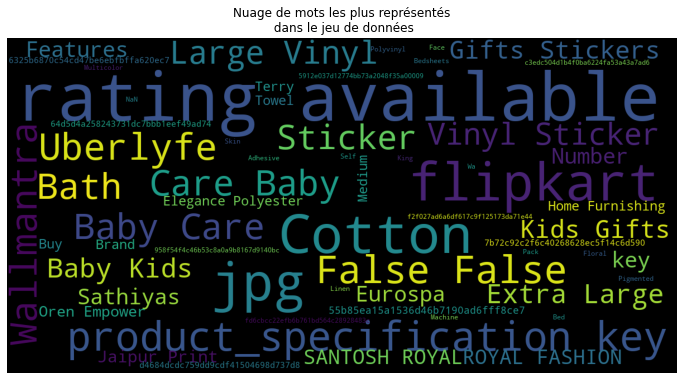

In [13]:
# Appel à la fonction pour afficher le nuage de points
show_wordcloud(data= data_nlp, title = None) 

## Interressons nous aux catégories de produits

In [14]:
# La somme totale des différents modalité du catégories de produits
data_nlp['product_category_tree'].nunique()

642

In [15]:
# Vérification des échantillons
data_nlp['product_category_tree'][612]

'["Baby Care >> Feeding & Nursing >> Bibs & Hankies >> Bibs >> Cheeky Chompers Bibs >> Cheeky Chompers The Neckerchew - Simple Classic ..."]'

Nous voyons que la colonne catégorie a une catégorie principale et des sous catégories,

In [16]:
data_nlp['product_category_tree'].to_list()

['["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]',
 '["Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Y..."]',
 '["Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Eurospa Baby Bath Towels >> Eurospa Cotton Terry Face Towel Set (20 PIECE FA..."]',
 '["Home Furnishing >> Bed Linen >> Bedsheets >> SANTOSH ROYAL FASHION Bedsheets >> SANTOSH ROYAL FASHION Cotton Printed King sized ..."]',
 '["Home Furnishing >> Bed Linen >> Bedsheets >> Jaipur Print Bedsheets >> Jaipur Print Cotton Floral King sized Double Bed..."]',
 '["Watches >> Wrist Watches >> Maserati Time Wrist Watches"]',
 '["Watches >> Wrist Watches >> Camerii Wrist Watches"]',
 '["Watches >> Wrist Watches >> T STAR Wrist Watches"]',
 '["Watches >> Wrist Watches >> Alfajr Wrist Watches"]',
 '["Watches >> Wrist Watches >> TAG Heuer Wrist Watches"]',
 '["Watches >> Wrist Watches >> C

### Création d'une fonction pour les catégories de produits

On a plus de 642 catégories de produits, donc pour les classer en des niveaux de catégories on crée la fonction pour faire séparer les produits.

In [17]:
#Traitement des catégories
def split_categories(category, level):
    '''Fonction qui affiche les '''
    category = category.split('["')[1].split('"]')[0]
    cat = category.split(' >> ')
    if(len(cat)) < 3:
        cat = [cat[0], cat[1], 'None']
        if(len(cat))<2:
            cat = [cat[0], 'None', 'None']
    return cat[level]


# Fonction de transformation
def split_categories_1(category):
    return split_categories(category,0)
def split_categories_2(category):
    return split_categories(category,1)
def split_categories_3(category):
    return split_categories(category,2)

In [18]:
# Création de nouvelles variables des catégories de produits
def retail_categories(dataframe):
    dataframe['cat_lvl_1'] = dataframe['product_category_tree'].apply(split_categories_1)
    dataframe['cat_lvl_2'] = dataframe['product_category_tree'].apply(split_categories_2)
    dataframe['cat_lvl_3'] = dataframe['product_category_tree'].apply(split_categories_3)
    return dataframe.drop(['product_category_tree'], axis=1)

In [19]:
# Appel à la fonction
data_nlp = retail_categories(data_nlp)
pd.set_option("display.max_column",17)
data_nlp.sample(3)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,cat_lvl_1,cat_lvl_2,cat_lvl_3
858,fffa2117a4006d4a848eb7d5b80d4816,2015-12-29 05:07:38 +0000,http://www.flipkart.com/de-techinn-flexible-wi...,De TechInn Flexible wire powered by 13 USB Led...,USGEDQPJS7KAZRXF,599.0,219.0,fffa2117a4006d4a848eb7d5b80d4816.jpg,False,Buy De TechInn Flexible wire powered by 13 USB...,No rating available,No rating available,De TechInn,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Computers,Laptop Accessories,USB Gadgets
968,634c89325a6c7752985a74a67f985c1f,2016-05-26 12:20:35 +0000,http://www.flipkart.com/sparklings-cotton-chec...,Sparklings Cotton Checkered Double Bedsheet,BDSEGZCETASFKSBF,1199.0,549.0,634c89325a6c7752985a74a67f985c1f.jpg,False,Key Features of Sparklings Cotton Checkered Do...,No rating available,No rating available,Sparklings,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Baby Care,Baby Bedding,Baby Bedsheets
478,a0133654f3911e47f021da4e49d42926,2016-03-18 07:48:11 +0000,http://www.flipkart.com/cotonex-yellow-green-c...,"Cotonex Yellow, Green Cotton Kitchen Linen Set",KLSEGUGFRDBSSEDM,350.0,299.0,a0133654f3911e47f021da4e49d42926.jpg,False,"Cotonex Yellow, Green Cotton Kitchen Linen Set...",No rating available,No rating available,Cotonex,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Kitchen & Dining Linen,Kitchen Linen Sets


In [20]:
data_nlp["cat_lvl_1"].nunique()

7

In [21]:
data_nlp.groupby("cat_lvl_1").count()["uniq_id"].sort_values(ascending=False)

cat_lvl_1
Baby Care                     150
Beauty and Personal Care      150
Computers                     150
Home Decor & Festive Needs    150
Home Furnishing               150
Kitchen & Dining              150
Watches                       150
Name: uniq_id, dtype: int64

### Exploration des catégories

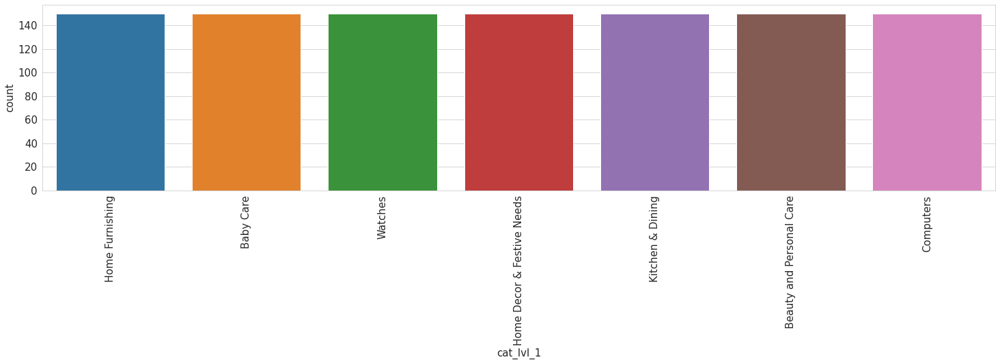

In [22]:
# Visualisation des deux pnns_groups
plt.rcParams.update({ "font.size" : 15})
sns.set_style("whitegrid")
plt.figure(figsize=(25,5))
sns.countplot(data_nlp["cat_lvl_1"], order=data_nlp["cat_lvl_1"].value_counts(ascending=False).index)
plt.xticks(rotation=90);

In [23]:
data_nlp["cat_lvl_2"].nunique()

62

In [24]:
data_nlp.groupby("cat_lvl_2").count()["uniq_id"].sort_values(ascending=False)

cat_lvl_2
Wrist Watches                149
Laptop Accessories            87
Infant Wear                   84
Coffee Mugs                   74
Showpieces                    71
                            ... 
Dinnerware & Crockery          1
Men's Grooming                 1
Beauty Accessories             1
Kripa's Home Furnishing        1
Consumables & Disposables      1
Name: uniq_id, Length: 62, dtype: int64

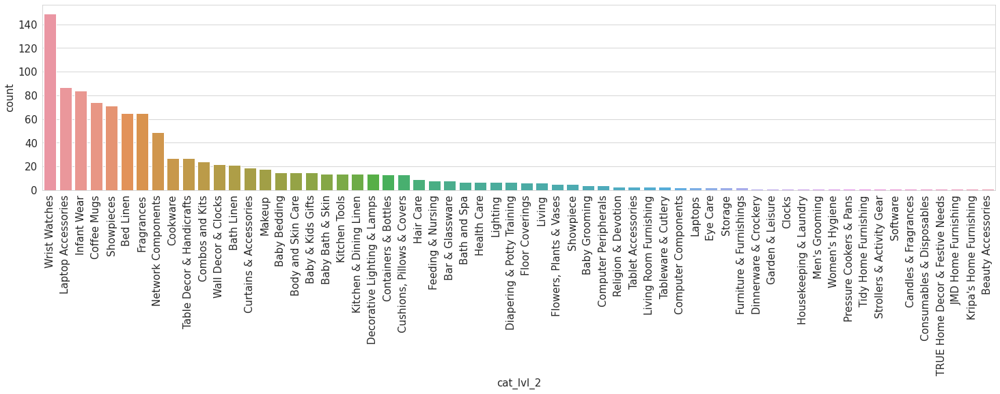

In [25]:
# Visualisation des deux pnns_groups
plt.rcParams.update({ "font.size" : 15})
sns.set_style("whitegrid")
plt.figure(figsize=(25,5))
sns.countplot(data_nlp["cat_lvl_2"], order=data_nlp["cat_lvl_2"].value_counts(ascending=False).index)
plt.xticks(rotation=90);

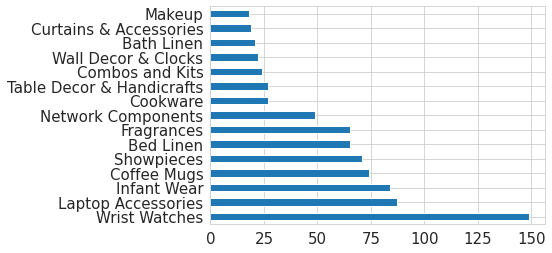

In [26]:
# Visualisation des 15 meilleurs catégories de produit
sns.set_style("whitegrid")
top_categories = data_nlp["cat_lvl_2"].value_counts().sort_values(ascending=False).head(15)
top_categories.plot(kind="barh")

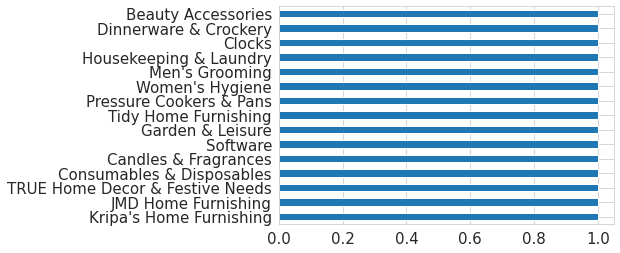

In [27]:
# Visualisation des 15 derniers catégories de produit
sns.set_style("whitegrid")
last_categories = data_nlp["cat_lvl_2"].value_counts().sort_values(ascending=False).tail(15)
last_categories.plot(kind="barh") 

In [28]:
data_nlp["cat_lvl_3"].nunique()

242

In [29]:
data_nlp.groupby("cat_lvl_3").count()["uniq_id"].sort_values(ascending=False)

cat_lvl_3
Deodorants                   65
Blankets, Quilts & Dohars    57
Baby Girls' Clothes          49
Routers                      49
USB Gadgets                  38
                             ..
Makeup Accessories            1
Malhar Showpieces             1
Mars Combos and Kits          1
Marvel Wrist Watches          1
posterchacha Coffee Mugs      1
Name: uniq_id, Length: 242, dtype: int64

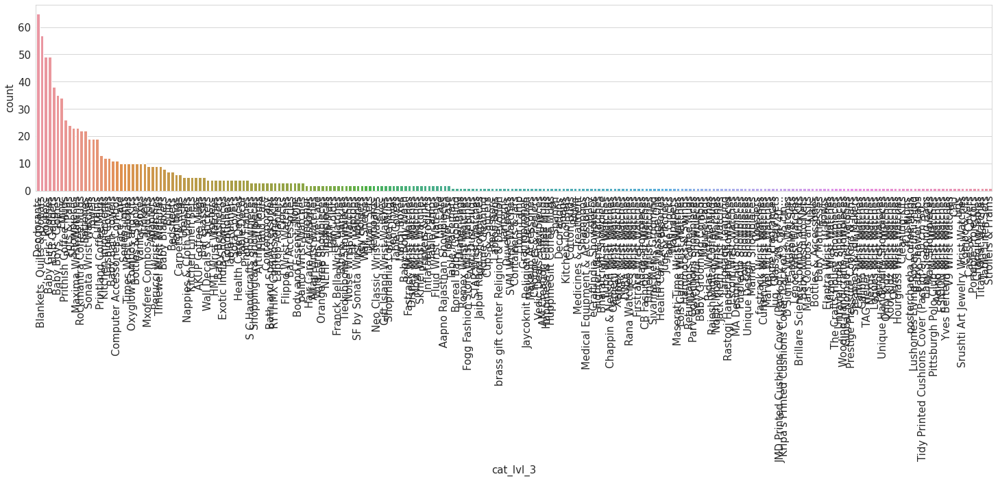

In [30]:
# Visualisation des deux pnns_groups
plt.rcParams.update({ "font.size" : 15})
sns.set_style("whitegrid")
plt.figure(figsize=(25,5))
sns.countplot(data_nlp["cat_lvl_3"], order=data_nlp["cat_lvl_3"].value_counts(ascending=False).index)
plt.xticks(rotation=90);

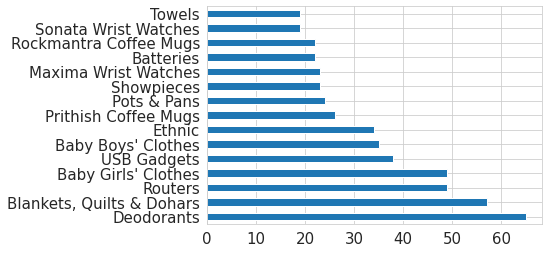

In [31]:
# Visualisation des 15 meilleurs catégories de produit
sns.set_style("whitegrid")
top_categories = data_nlp["cat_lvl_3"].value_counts().sort_values(ascending=False).head(15)
top_categories.plot(kind="barh") 

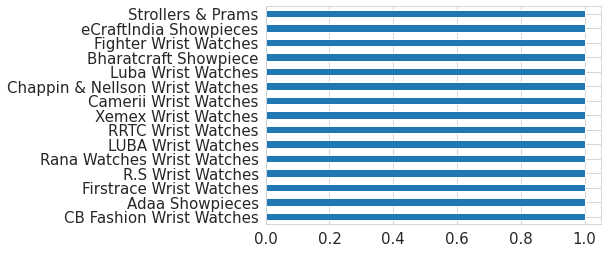

In [32]:
# Visualisation des 15 derniers catégories de produit
sns.set_style("whitegrid")
last_categories = data_nlp["cat_lvl_3"].value_counts().sort_values(ascending=False).tail(15)
last_categories.plot(kind="barh") 

# Données textuelles

## Interressons nous à la description des articles

Le preprocessing comporte plusieurs étapes souvent complémentaires. Nous allons ici découvrir les plus courantes, à savoir :

Normalisation du texte

Tokénization

Suppression des stopwords

Lemmatization (ou Stemming)

N-grams

In [33]:
# Voyons à quoi ressemblent quelques commentaires pris au hasard
data_nlp[['description']].sample(3)

,description
891,"LukLuck Cotton Bath Towel (Bath Towel, Multico..."
184,Buy Prithish Pschedelic Collection 1 Ceramic M...
537,Maxima 01784BMLY Gold Analog Watch - For Wome...


In [34]:
data_nlp[['description']].shape

(1050, 1)

In [35]:
data_nlp['description'].iloc[960]

'Cotonex Beige Cotton Kitchen Linen Set (Pack of 2) Price: Rs. 299 Reviews of Cotonex 100% Pure Cotton Glove,Specifications of Cotonex Beige Cotton Kitchen Linen Set (Pack of 2) General Brand Cotonex Design Code KLS221 Material Cotton Style Code 56213KLS221 Pattern Solid Design Solid Design Color Beige Dimensions Weight 150 Additional Features Fabric Care Machine washable, do not dry clean, do not bleach In the Box Number of Contents in Sales Package Pack of 2 Sales Package 2 Glove'

In [36]:
data_nlp['description'].iloc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [37]:
# création d'un corpus de toutes les descriptions
corpus = ' '.join(data_nlp['description'].values)
print("Nombre total de mots dans tout le corpus: ", len(corpus.split()))

Nombre total de mots dans tout le corpus:  80013


In [38]:
print(corpus)

Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you 

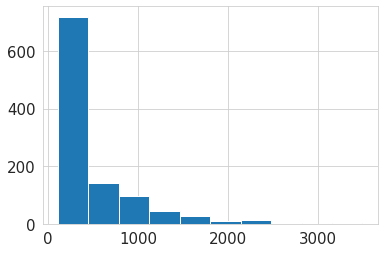

In [39]:
# Visualisation du nombre de caractères présent dans chaque description
data_nlp['description'].str.len().hist()

L'histogramme montre que les descriptions des articles vont de 100 à 2500 caractères et généralement entre 250 et 300 caractères

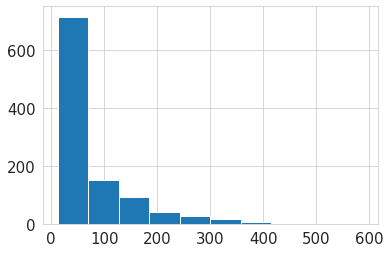

In [40]:
# Visualisons le nombre de mots dans chaque description
data_nlp['description'].str.split().\
    map( lambda x: len(x)).\
    hist()

Le nombre de mots dans chaque descriptions varie de 50 à 400 mots et se situe généralement entre 40 et 70 mots

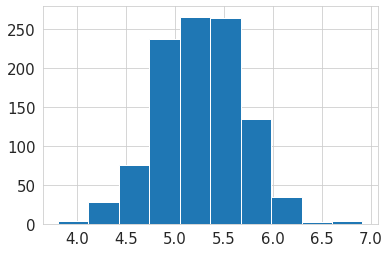

In [41]:
# Visualisons la longueur moyenne des mots dans chaque description.
data_nlp['description'].str.split().\
   apply( lambda x : [len(i) for i in x]).\
   map( lambda x : np.mean(x)).hist()

La longueur moyenne des mots varie entre 4 et 6 , 5 étant la longeur la plus courante . Cela signifie-t-il que les gens utilisent des mots très courts dans les gros titres.

Comme ces mots sont probablement de petite longueur, ces mots peuvent avoir entraîné une distorsion à gauche du graphique ci-dessus.

Pour obtenir le corpus contenant les mots vides, vous pouvez utiliser la  bibliothèque nltk . Nltk contient des mots vides de nombreuses langues. Puisque nous ne traitons que des descriptions en anglais, je vais filtrer les mots vides en anglais du corpus.

In [42]:
from string import punctuation
from nltk.corpus import stopwords
stopwords_nltk = set(stopwords.words('english'))
stopwords_punct = set(punctuation)

In [43]:
# Afficher les ponctuations et stopwords
print(stopwords_nltk)

print("-------------------------------------------------------------")

print(punctuation)

{'weren', 'down', "that'll", 'of', "won't", 'this', 'through', 'shouldn', 'have', 'haven', "wouldn't", 'shan', 'on', 'for', 'from', 'then', 'their', 'as', 'hadn', 'off', 'those', 'mightn', 'y', 'needn', "shouldn't", 'ma', 'that', 'before', 'd', "aren't", 're', 'they', 'how', 'very', 'doesn', "you've", 'so', 'be', 'him', 'whom', 'by', 'further', 'he', 'will', 'doing', 'yours', 'the', 'here', 'in', 'any', 'only', "haven't", 'aren', 'why', 'had', 'both', 'itself', 'been', 'll', 'ain', 'couldn', 'isn', 'above', 'mustn', 'once', 'was', 'too', 'just', 'during', "she's", 'who', 'you', 'nor', "don't", 'didn', 'his', 'being', 'my', 'were', "it's", 'now', 'i', 'himself', 'them', 'am', 'it', 'wouldn', 'our', 'm', 'ours', 'where', 'to', 'other', 'own', 'but', 'what', 'same', 'don', 'between', "wasn't", "you'd", 'your', 'below', "hasn't", 'are', "you're", 'some', 'at', 'than', 'over', 'me', 'or', "doesn't", 'with', 'did', "mustn't", 'themselves', 'herself', 'having', 'does', 'o', "didn't", "you'll"

In [44]:
corpus=[]
data= data_nlp['description'].str.split()
data=data_nlp.values
corpus=[word for i in data_nlp for word in i]

from collections import defaultdict
dic = defaultdict(int)
for word in corpus:
    if word in stopwords_nltk:
        dic[word]+=1

In [45]:
# Afficher la liste des mots vides(peu informatif)
print(corpus)

['u', 'n', 'i', 'q', '_', 'i', 'd', 'c', 'r', 'a', 'w', 'l', '_', 't', 'i', 'm', 'e', 's', 't', 'a', 'm', 'p', 'p', 'r', 'o', 'd', 'u', 'c', 't', '_', 'u', 'r', 'l', 'p', 'r', 'o', 'd', 'u', 'c', 't', '_', 'n', 'a', 'm', 'e', 'p', 'i', 'd', 'r', 'e', 't', 'a', 'i', 'l', '_', 'p', 'r', 'i', 'c', 'e', 'd', 'i', 's', 'c', 'o', 'u', 'n', 't', 'e', 'd', '_', 'p', 'r', 'i', 'c', 'e', 'i', 'm', 'a', 'g', 'e', 'i', 's', '_', 'F', 'K', '_', 'A', 'd', 'v', 'a', 'n', 't', 'a', 'g', 'e', '_', 'p', 'r', 'o', 'd', 'u', 'c', 't', 'd', 'e', 's', 'c', 'r', 'i', 'p', 't', 'i', 'o', 'n', 'p', 'r', 'o', 'd', 'u', 'c', 't', '_', 'r', 'a', 't', 'i', 'n', 'g', 'o', 'v', 'e', 'r', 'a', 'l', 'l', '_', 'r', 'a', 't', 'i', 'n', 'g', 'b', 'r', 'a', 'n', 'd', 'p', 'r', 'o', 'd', 'u', 'c', 't', '_', 's', 'p', 'e', 'c', 'i', 'f', 'i', 'c', 'a', 't', 'i', 'o', 'n', 's', 'c', 'a', 't', '_', 'l', 'v', 'l', '_', '1', 'c', 'a', 't', '_', 'l', 'v', 'l', '_', '2', 'c', 'a', 't', '_', 'l', 'v', 'l', '_', '3']


In [46]:
# Fonction pour visualiser les mots vides
def plot_top_stopwords_barchart(text):
    stop=set(stopwords.words('english'))
    
    data_corpus= data_nlp['description'].str.split()
    data_corpus=data_nlp.values
    corpus=[word for i in data_nlp for word in i]

    from collections import defaultdict
    dic=defaultdict(int)
    for word in corpus:
        if word in stopwords_nltk:
            dic[word]+=1
            
    top=sorted(dic.items(), key=lambda x:x[1],reverse=True)[:10] 
    x,y=zip(*top)
    plt.bar(x,y)       

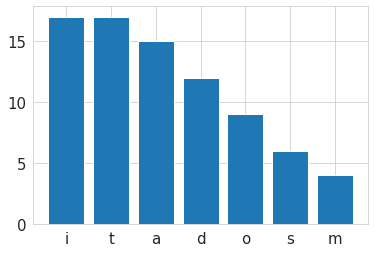

In [47]:
# Visualisation des mots vides 
plot_top_stopwords_barchart(data_nlp['description'])

Nous pouvons évidemment voir que les mots vides tels que "i", "t" et "a" dominent dans les descriptions.

Alors maintenant  que nous savons quels mots vides apparaissent fréquemment dans les descriptions, examinons quels autres mots que ces mots vides apparaissent fréquemment.

Nous utiliserons la  fonction compteur  de la bibliothèque de collections pour compter et stocker les occurrences de chaque mot dans une liste de tuples. C'est une  fonction très utile lorsque nous traitons de l'analyse  au niveau du mot dans le traitement du langage naturel.

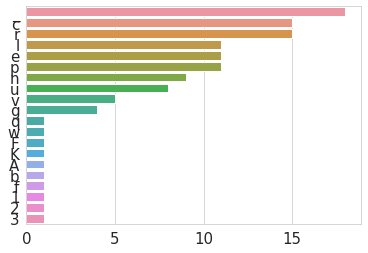

In [48]:
from collections import Counter
counter=Counter(corpus)
most=counter.most_common()

x, y= [], []
for word,count in most[:40]:
    if (word not in stopwords_nltk):
        x.append(word)
        y.append(count)

     
    sns.barplot(x=y,y=x)

In [49]:
# Conteur
print(counter)

Counter({'_': 18, 'i': 17, 't': 17, 'c': 15, 'r': 15, 'a': 15, 'd': 12, 'l': 11, 'e': 11, 'p': 11, 'n': 9, 'o': 9, 'u': 8, 's': 6, 'v': 5, 'm': 4, 'g': 4, 'q': 1, 'w': 1, 'F': 1, 'K': 1, 'A': 1, 'b': 1, 'f': 1, '1': 1, '2': 1, '3': 1})


In [50]:
# Fréquence totale de tous les mots
print(most)

[('_', 18), ('i', 17), ('t', 17), ('c', 15), ('r', 15), ('a', 15), ('d', 12), ('l', 11), ('e', 11), ('p', 11), ('n', 9), ('o', 9), ('u', 8), ('s', 6), ('v', 5), ('m', 4), ('g', 4), ('q', 1), ('w', 1), ('F', 1), ('K', 1), ('A', 1), ('b', 1), ('f', 1), ('1', 1), ('2', 1), ('3', 1)]


Regarder les n-grammes les plus fréquents peut vous donner une meilleure compréhension du contexte  dans lequel le mot a été utilisé.

Pour construire une représentation de notre vocabulaire nous allons utiliser  Countvectorizer

CountVectorizer implémente à la fois la tokenisation et le comptage d'occurrences dans une seule classe, Utilisons-le pour tokeniser et compter les occurrences de mots d'un corpus minimaliste de documents texte.

In [51]:
from nltk.util import ngrams
def plot_top_ngrams_barchart(text, n=2):
    stop=set(stopwords.words('english'))

    new= text.str.split()
    new=new.values.tolist()
    corpus=[word for i in new for word in i]

    def _get_top_ngram(corpus, n=None):
        vec = CountVectorizer(ngram_range=(n, n)).fit(corpus)
        bag_of_words = vec.transform(corpus)
        sum_words = bag_of_words.sum(axis=0) 
        words_freq = [(word, sum_words[0, idx]) 
                      for word, idx in vec.vocabulary_.items()]
        words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
        return words_freq[:10]

    top_n_bigrams=_get_top_ngram(text,n)[:10]
    x,y=map(list,zip(*top_n_bigrams))
    sns.barplot(x=y,y=x)

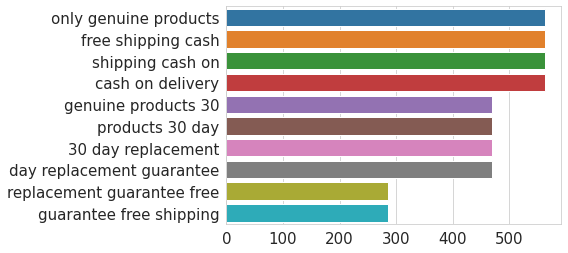

In [52]:
plot_top_ngrams_barchart(data_nlp['description'],3)

Nous pouvons voir que beaucoup de ces trigrammes sont des combinaisons du mode de payement, le mode d'expédition , la garantie.

Cela signifie que nous devrions faire des efforts pour nettoyer les données  et voir si nous pouvions combiner ces termes synonymes en un seul jeton propre.

Il peut être pertinent d'aller chercher plusieurs listes de stopwords et de les fusionner pour avoir un dictionnaire plus complet.

In [53]:
"""
# Création d'une liste de stopwords
stopwords_en = set(["ai","had","a","as","have","is","was","la","a","b","c","d","e","f","g","h","i",
                   "little","in","this","at","seen","do","for","one","nan","of","and","we","z",
                    "that ","if","the","it","ma","you","y","c","des","on","t","d","j","k","l",
                    "one","the","i", "don't","not","these","m","qu","needed","m","n","o","p","y",
                    "or","of","do","do","me","fur ","but","all","are","not","not","not","q","t","u","v",
                    "all","are","without", "an","qui","it's","case","by","memes","meme","r","w","x",
                    "under","would have","despite","were","really","therefore","your","rather","past",
                    "don't","have","also","have","enough","too much","less","better","grace","this",
                    "thing","true","see ","choose","find","day","learned","think","well","hello"])
                    """

'\n# Création d\'une liste de stopwords\nstopwords_en = set(["ai","had","a","as","have","is","was","la","a","b","c","d","e","f","g","h","i",\n                   "little","in","this","at","seen","do","for","one","nan","of","and","we","z",\n                    "that ","if","the","it","ma","you","y","c","des","on","t","d","j","k","l",\n                    "one","the","i", "don\'t","not","these","m","qu","needed","m","n","o","p","y",\n                    "or","of","do","do","me","fur ","but","all","are","not","not","not","q","t","u","v",\n                    "all","are","without", "an","qui","it\'s","case","by","memes","meme","r","w","x",\n                    "under","would have","despite","were","really","therefore","your","rather","past",\n                    "don\'t","have","also","have","enough","too much","less","better","grace","this",\n                    "thing","true","see ","choose","find","day","learned","think","well","hello"])\n                    '

In [54]:
# Combinaison des trois stopwords
#stopwords_combined = set.union(stopwords_nltk, stopwords_punct,stopwords_en)

## Nuage de mots

In [55]:
stopwords = stopwords_nltk
corpus = ' '.join(data_nlp['description'].values)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='BLACK',
        stopwords=stopwords,
        max_words=500,
        max_font_size=40, 
        scale=3,
        random_state=1).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)
        
    plt.title("Nuage de mots les plus représentés" "\n dans le corpus")
    plt.imshow(wordcloud)
    plt.show()

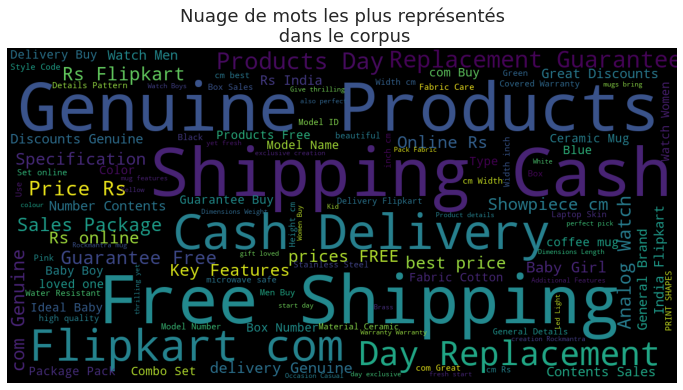

In [56]:
# Appel à la fonction pour afficher le nuage de points
show_wordcloud(data= corpus, title = None) 

TfidfVectorizer qui combine toutes les options de CountVectorizer et TfidfTransformer dans un seul modèle 

# Transformation du corpus (extraction de features)

In [57]:
def taille_mot(base,colonne):
    corpus=base[colonne]
    words_dico=dict()
    import re
     #importation des expressions réguliéres
    expr = re.compile("\W+",re.U) # Expression régulière de segmentation sur les espaces
    for text in corpus: # Pour chaque commentaire du corpus
        text = str(text)
        text = expr.split(text)
        for word in set(text): # Récupération de chaque nouveau mot
            if word not in words_dico:
                words_dico[word]=1
            else: 
          # Pour chaque mot déjà listé : ajouter 1 si on le retrouve
              words_dico[word]=words_dico[word]+1

    return len(words_dico)

In [58]:
taille_debut=taille_mot(data_nlp,'description')#7671
print(taille_debut)

7671


## Les ponctuations

In [59]:
from string import punctuation
stopwords_punct = set(punctuation)

In [60]:
print(punctuation)

!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~


Création d'une fonction pour supprimer les ponctuations

In [61]:
# Suppression des ponctuations
def remove_punctuation(corpus):
    corpus_nopunct ="".join([w for w in corpus if w not in punctuation])
    return corpus_nopunct                        

In [62]:
# Appel à la fonction
remove_punctuation(data_nlp["description"][5])

'Maserati Time R8851116001 Analog Watch   For Boys  Buy Maserati Time R8851116001 Analog Watch   For Boys  R8851116001 Online at Rs24400 in India Only at Flipkartcom  Great Discounts Only Genuine Products 30 Day Replacement Guarantee Free Shipping Cash On Delivery'

In [63]:
# Création d'une variable pour comparer avant et aprés suppression des ponctuations
data_nlp['description_nopunc']=data_nlp['description'].apply(lambda x: remove_punctuation(x))
data_nlp[['description','description_nopunc']].head(6)

,description,description_nopunc
0,Key Features of Elegance Polyester Multicolor ...,Key Features of Elegance Polyester Multicolor ...
1,Specifications of Sathiyas Cotton Bath Towel (...,Specifications of Sathiyas Cotton Bath Towel 3...
2,Key Features of Eurospa Cotton Terry Face Towe...,Key Features of Eurospa Cotton Terry Face Towe...
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,Key Features of Jaipur Print Cotton Floral Kin...,Key Features of Jaipur Print Cotton Floral Kin...
5,Maserati Time R8851116001 Analog Watch - For ...,Maserati Time R8851116001 Analog Watch For B...


In [64]:
taille_filtre1=taille_mot(data_nlp,'description_nopunc')#8212
print(taille_filtre1)

8212


## Les chiffres dans le corpus

Création d'une fonction pour supprimer les chiffres

In [65]:
# on va remplacer tous les chiffres qu'on trouve par un espace
def replace(string):
    string.replace('[0-9]','')
    return string

In [66]:
import nltk
nltk.download('punkt')
def Harmonisation(text):
    tokenizer = nltk.RegexpTokenizer(r'\w+') 
    tokens=tokenizer.tokenize(text)
    return tokens

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [67]:
data_nlp['description_nodg']=data_nlp['description_nopunc'].str.replace('[0-9]','')
data_nlp[['description','description_nopunc','description_nodg']].head(6)

,description,description_nopunc,description_nodg
0,Key Features of Elegance Polyester Multicolor ...,Key Features of Elegance Polyester Multicolor ...,Key Features of Elegance Polyester Multicolor ...
1,Specifications of Sathiyas Cotton Bath Towel (...,Specifications of Sathiyas Cotton Bath Towel 3...,Specifications of Sathiyas Cotton Bath Towel ...
2,Key Features of Eurospa Cotton Terry Face Towe...,Key Features of Eurospa Cotton Terry Face Towe...,Key Features of Eurospa Cotton Terry Face Towe...
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,Key Features of Jaipur Print Cotton Floral Kin...,Key Features of Jaipur Print Cotton Floral Kin...,Key Features of Jaipur Print Cotton Floral Kin...
5,Maserati Time R8851116001 Analog Watch - For ...,Maserati Time R8851116001 Analog Watch For B...,Maserati Time R Analog Watch For Boys Buy M...


In [68]:
taille_filtre2=taille_mot(data_nlp,'description_nodg') #7243
print(taille_filtre2)

7243


## Normalisation et Tokenisation

In [69]:
import nltk
nltk.download('punkt')
def Tokennisationetnorm(text):
    tokens=nltk.word_tokenize(text.lower())
    return tokens

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [70]:
data_nlp['description_token']=data_nlp['description_nodg'].apply(lambda x : Tokennisationetnorm(x))
data_nlp[['description','description_nodg','description_token']].head(5)

,description,description_nodg,description_token
0,Key Features of Elegance Polyester Multicolor ...,Key Features of Elegance Polyester Multicolor ...,"[key, features, of, elegance, polyester, multi..."
1,Specifications of Sathiyas Cotton Bath Towel (...,Specifications of Sathiyas Cotton Bath Towel ...,"[specifications, of, sathiyas, cotton, bath, t..."
2,Key Features of Eurospa Cotton Terry Face Towe...,Key Features of Eurospa Cotton Terry Face Towe...,"[key, features, of, eurospa, cotton, terry, fa..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[key, features, of, santosh, royal, fashion, c..."
4,Key Features of Jaipur Print Cotton Floral Kin...,Key Features of Jaipur Print Cotton Floral Kin...,"[key, features, of, jaipur, print, cotton, flo..."


In [71]:
taille_filtre3=taille_mot(data_nlp,'description_token')
print(taille_filtre3)

5674


## Suppression des stops words

In [72]:
import nltk
nltk.download('stopwords')
stopword=nltk.corpus.stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [73]:
print(stopword)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [74]:
def suppression_word(text):
    text=[word for word in text if word not in stopword]
    return text

In [75]:
data_nlp['description_stop']=data_nlp['description_token'].apply(lambda x : suppression_word(x))
data_nlp[['description','description_nodg','description_token', 'description_stop']].head(5)

,description,description_nodg,description_token,description_stop
0,Key Features of Elegance Polyester Multicolor ...,Key Features of Elegance Polyester Multicolor ...,"[key, features, of, elegance, polyester, multi...","[key, features, elegance, polyester, multicolo..."
1,Specifications of Sathiyas Cotton Bath Towel (...,Specifications of Sathiyas Cotton Bath Towel ...,"[specifications, of, sathiyas, cotton, bath, t...","[specifications, sathiyas, cotton, bath, towel..."
2,Key Features of Eurospa Cotton Terry Face Towe...,Key Features of Eurospa Cotton Terry Face Towe...,"[key, features, of, eurospa, cotton, terry, fa...","[key, features, eurospa, cotton, terry, face, ..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[key, features, of, santosh, royal, fashion, c...","[key, features, santosh, royal, fashion, cotto..."
4,Key Features of Jaipur Print Cotton Floral Kin...,Key Features of Jaipur Print Cotton Floral Kin...,"[key, features, of, jaipur, print, cotton, flo...","[key, features, jaipur, print, cotton, floral,..."


In [76]:
taille_filtre4=taille_mot(data_nlp,'description_stop')
print(taille_filtre4)

5559


## Racinisation (Stemming)

In [77]:
from nltk.stem.snowball import EnglishStemmer
stemm=EnglishStemmer()
def stem_word(text):
    stem_text=[stemm.stem(word)for word in text] 
    return stem_text

In [78]:
data_nlp['description_stem']=data_nlp['description_stop'].apply(lambda x : stem_word(x))
data_nlp[['description','description_nodg','description_token', 'description_stop','description_stem']].head(5)

,description,description_nodg,description_token,description_stop,description_stem
0,Key Features of Elegance Polyester Multicolor ...,Key Features of Elegance Polyester Multicolor ...,"[key, features, of, elegance, polyester, multi...","[key, features, elegance, polyester, multicolo...","[key, featur, eleg, polyest, multicolor, abstr..."
1,Specifications of Sathiyas Cotton Bath Towel (...,Specifications of Sathiyas Cotton Bath Towel ...,"[specifications, of, sathiyas, cotton, bath, t...","[specifications, sathiyas, cotton, bath, towel...","[specif, sathiya, cotton, bath, towel, bath, t..."
2,Key Features of Eurospa Cotton Terry Face Towe...,Key Features of Eurospa Cotton Terry Face Towe...,"[key, features, of, eurospa, cotton, terry, fa...","[key, features, eurospa, cotton, terry, face, ...","[key, featur, eurospa, cotton, terri, face, to..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[key, features, of, santosh, royal, fashion, c...","[key, features, santosh, royal, fashion, cotto...","[key, featur, santosh, royal, fashion, cotton,..."
4,Key Features of Jaipur Print Cotton Floral Kin...,Key Features of Jaipur Print Cotton Floral Kin...,"[key, features, of, jaipur, print, cotton, flo...","[key, features, jaipur, print, cotton, floral,...","[key, featur, jaipur, print, cotton, floral, k..."


In [79]:
taille_mot(data_nlp,'description_stem')

4575

In [80]:
#fonction pour supprimer les nombres dans notre stem
import re
from string import digits
def word1(text) :
    string=text
    table = str.maketrans('', '', digits)
    newstring = string.translate(table)
    return newstring

In [81]:
def word(text) :
    string=text

    newstring = " ".join([i for i in string if not i.isdigit()])
    return (newstring)

In [82]:
# affichage aprés suppression des nombres dans notre stem
data_nlp['description_stem'].head()

0    [key, featur, eleg, polyest, multicolor, abstr...
1    [specif, sathiya, cotton, bath, towel, bath, t...
2    [key, featur, eurospa, cotton, terri, face, to...
3    [key, featur, santosh, royal, fashion, cotton,...
4    [key, featur, jaipur, print, cotton, floral, k...
Name: description_stem, dtype: object

In [83]:
taille_mot(data_nlp,'description_stem')

4575

## Suppression des mots avec peu de caractères

In [84]:
# Définissons une fonction
def rem_short_words(words_list, char_len = 2):
    word_len = [len(i) for i in words_list]
    index_keep = np.array(word_len) > char_len
    words_list_red = np.array(words_list)[index_keep]
    return(list(words_list_red))

In [85]:
data_nlp['description_stem1'] = data_nlp['description_stem'].apply(rem_short_words)
data_nlp[['description_stem','description_stem1']].head()

,description_stem,description_stem1
0,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr..."
1,"[specif, sathiya, cotton, bath, towel, bath, t...","[specif, sathiya, cotton, bath, towel, bath, t..."
2,"[key, featur, eurospa, cotton, terri, face, to...","[key, featur, eurospa, cotton, terri, face, to..."
3,"[key, featur, santosh, royal, fashion, cotton,...","[key, featur, santosh, royal, fashion, cotton,..."
4,"[key, featur, jaipur, print, cotton, floral, k...","[key, featur, jaipur, print, cotton, floral, k..."


In [86]:
taille_mot(data_nlp,'description_stem1')

4437

In [87]:
len(data_nlp["description_stem1"])

1050

## Fréquence des mots

In [88]:
corpus = data_nlp['description_stem1']
words_dico = dict()
import re
#importation des expressions réguliéres

expr = re.compile("\W+",re.U) # Expression régulière de segmentation sur les espaces
for text in corpus: # Pour chaque commentaire du corpus
    text = str(text)
    text = expr.split(text)
    for word in set(text): # Récupération de chaque nouveau mot
        if word not in words_dico:
            words_dico[word] = 1
    else: 
        # Pour chaque mot déjà listé : ajouter 1 si on le retrouve
          words_dico[word]=words_dico[word]+1

print(words_dico)

{'': 1, 'slide': 1, 'moment': 1, 'polyest': 1, 'style': 1, 'content': 1, 'draw': 1, 'environ': 1, 'good': 1, 'look': 1, 'multicolor': 1, 'welcom': 1, 'made': 1, 'eleg': 1, 'abstract': 1, 'wrinkl': 1, 'morn': 1, 'stitch': 1, 'apart': 1, 'key': 1, 'model': 1, 'interiorsthi': 1, 'price': 16, 'brand': 1, 'general': 4, 'type': 90, 'door': 15, 'home': 1, 'ringit': 1, 'close': 1, 'beauti': 2, 'want': 1, 'make': 1, 'materi': 1, 'contemporari': 1, 'ray': 1, 'even': 1, 'bright': 1, 'heart': 1, 'filter': 1, 'lovingthi': 1, 'attent': 1, 'color': 1, 'curtaineleg': 1, 'floral': 1, 'light': 2, 'steal': 1, 'creat': 1, 'get': 1, 'featur': 1, 'apparanceg': 1, 'romant': 1, 'world': 1, 'box': 2, 'special': 1, 'print': 1, 'first': 1, 'sale': 1, 'set': 1, 'packag': 1, 'surreal': 1, 'shrinkag': 1, 'duster': 1, 'valanc': 1, 'name': 1, 'high': 1, 'sun': 1, 'wish': 1, 'joyous': 1, 'metal': 4, 'enhanc': 1, 'dimens': 7, 'bring': 30, 'number': 1, 'whole': 1, 'pack': 1, 'sure': 1, 'height': 1, 'eyelet': 1, 'bodi': 

In [89]:
len(words_dico)

4437

In [90]:
data_word_freq=pd.DataFrame({'Mots':words_dico.keys(),'Frequence':words_dico.values()})
data_word_freq.sample(5)

,Mots,Frequence
4390,bull,1
1523,optimum,1
1981,durabilityspecif,1
3170,ddrl,1
3794,reflex,1


##    Analyse de la féquence des mots

Text(0.5, 1.0, 'La fréquence maximale est de 200')

<Figure size 1440x720 with 0 Axes>

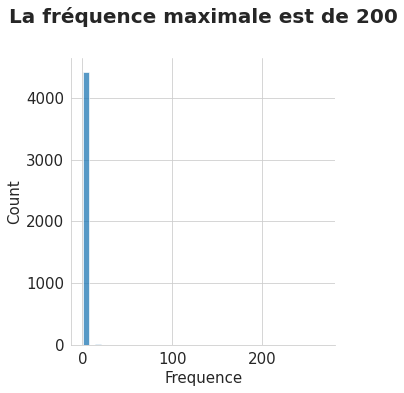

In [91]:
plt.figure(figsize=(20,10))
sns.displot(data=data_word_freq,bins=40, x="Frequence");
plt.title('La fréquence maximale est de 200', fontsize = 20, pad = 35, fontweight = 'bold')

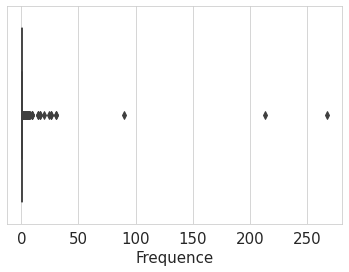

In [92]:
# Visualisation avec les boxplots
sns.boxplot(data=data_word_freq, x = 'Frequence')

On a une distribution assymetrique vers la droite et présence de valeurs abérantes(outliers)

In [93]:
data_word_freq['Frequence'].describe()

count    4437.000000
mean        1.236646
std         5.390469
min         1.000000
25%         1.000000
50%         1.000000
75%         1.000000
max       267.000000
Name: Frequence, dtype: float64

In [94]:
# Utilisation de freq dist pour voir les mots les plus fréquents 
freq = nltk.FreqDist(words_dico)
freq.most_common(50)

[('buy', 267),
 ('deliveri', 213),
 ('type', 90),
 ('bring', 30),
 ('neck', 30),
 ('dri', 26),
 ('microwav', 26),
 ('cotton', 24),
 ('kadhai', 20),
 ('price', 16),
 ('instal', 16),
 ('door', 15),
 ('right', 15),
 ('work', 9),
 ('show', 9),
 ('paper', 9),
 ('laptop', 8),
 ('dimens', 7),
 ('bedsheet', 7),
 ('vaniti', 7),
 ('check', 7),
 ('wooden', 6),
 ('fill', 6),
 ('care', 5),
 ('rang', 5),
 ('utensil', 5),
 ('gorgeous', 5),
 ('stone', 5),
 ('connector', 5),
 ('multipurpos', 5),
 ('scrub', 5),
 ('general', 4),
 ('metal', 4),
 ('inch', 4),
 ('whether', 4),
 ('steel', 4),
 ('duvet', 4),
 ('new', 4),
 ('four', 4),
 ('wild', 4),
 ('zyxel', 4),
 ('nearest', 4),
 ('procedur', 4),
 ('henc', 4),
 ('cover', 3),
 ('azan', 3),
 ('hous', 3),
 ('seri', 3),
 ('outdoor', 3),
 ('superior', 3)]

In [95]:
data_word_freq = data_word_freq.sort_values(by='Frequence',ascending=False)
data_word_freq.head()

,Mots,Frequence
221,buy,267
209,deliveri,213
25,type,90
638,neck,30
72,bring,30


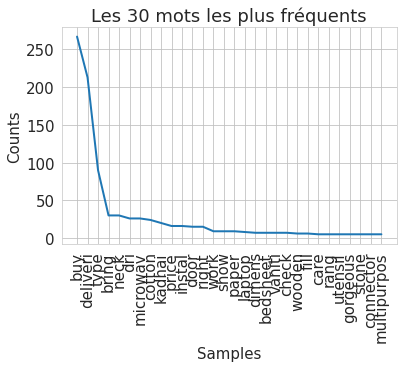

In [96]:
# Visualisation des 30 mots les plus fréquents
plt.figure()
freq.plot(30,cumulative=False,title='Les 30 mots les plus fréquents')

In [97]:
freq.pprint(maxlen=30)

FreqDist({'buy': 267, 'deliveri': 213, 'type': 90, 'bring': 30, 'neck': 30, 'dri': 26, 'microwav': 26, 'cotton': 24, 'kadhai': 20, 'price': 16, 'instal': 16, 'door': 15, 'right': 15, 'work': 9, 'show': 9, 'paper': 9, 'laptop': 8, 'dimens': 7, 'bedsheet': 7, 'vaniti': 7, 'check': 7, 'wooden': 6, 'fill': 6, 'care': 5, 'rang': 5, 'utensil': 5, 'gorgeous': 5, 'stone': 5, 'connector': 5, 'multipurpos': 5, ...})


In [98]:
len(words_dico)

4437

In [99]:
words_freq = list()

for key, val in words_dico.items():
    words_freq.append( (key, val) )
    words_freq.sort(key=lambda tup: tup[1] ,reverse=True)
print("Le mot le plus fréquent : ",words_freq[0])

Le mot le plus fréquent :  ('buy', 267)


In [100]:
len(words_freq)

4437

In [101]:
data_freq=data_word_freq.sort_values(by='Frequence',ascending=False)
data_freq=data_freq.reset_index(drop=True)
data_freq

,Mots,Frequence
0,buy,267
1,deliveri,213
2,type,90
3,neck,30
4,bring,30
...,...,...
4432,gown,1
4433,hospitalnurs,1
4434,femalesspecif,1
4435,tranquil,1


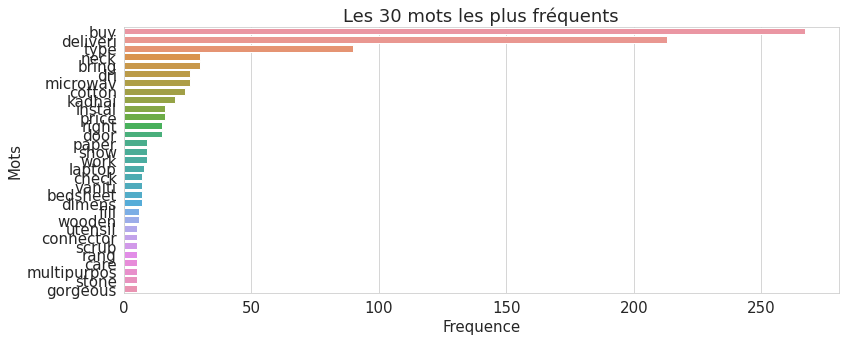

In [102]:
# Visualisation des 30 premiers mots les plus fréquent
data_1=data_freq.loc[0:30,['Mots','Frequence']]
plt.figure(figsize=(12,5))
sns.barplot(y='Mots',x='Frequence',data=data_1.sort_values('Frequence',ascending=False))
plt.title('Les 30 mots les plus fréquents')
plt.tight_layout()

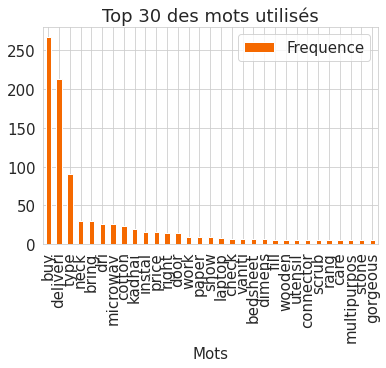

In [103]:
data_1.plot(kind='bar',x='Mots',y='Frequence', color="#f56900",title='Top 30 des mots utilisés')

In [104]:
# Trions par ordre décroissant du plus petit au plus grand
data_freq=data_word_freq.sort_values(by='Frequence',ascending=True)
data_freq=data_freq.reset_index(drop=True)

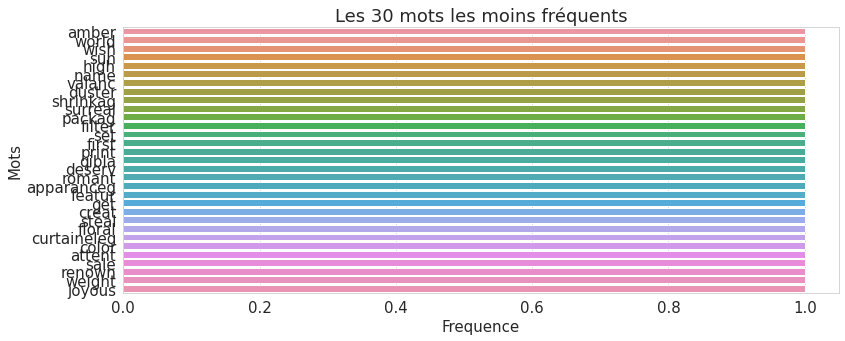

In [105]:
# Visualisation des 30 premiers mots les plus fréquent
data_2=data_freq.loc[0:30,['Mots','Frequence']]
data_2=data_2.reset_index(drop=True)
plt.figure(figsize=(12,5))
sns.barplot(y='Mots',x='Frequence',data=data_2.sort_values('Frequence',ascending=False))
plt.title('Les 30 mots les moins fréquents')
plt.tight_layout()

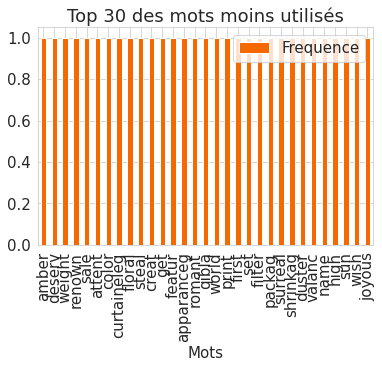

In [106]:
data_2.plot(kind='bar',x='Mots',y='Frequence', color="#f56900",title='Top 30 des mots moins utilisés')

Nous allons supprimer les mots avec une fréquence égal à 1 car avec cette faible fréquence , on aura pas beaucoup d'information sur la catégorisation .

In [107]:
print(len(data_word_freq['Frequence'].index[data_word_freq['Frequence']>200/2]),"mots aparaissent dans presque la moitié des descriptions")

2 mots aparaissent dans presque la moitié des descriptions


In [108]:
len(data_word_freq)

4437

In [109]:
i=data_word_freq['Frequence'][-10:].index
data_word_freq['Mots'][i]

1528         handl
1529      sandwich
1530         sharp
1531        cutter
1532       compact
1533        garlic
1534    handicraft
1535       rastogi
1536           neh
4436          film
Name: Mots, dtype: object

In [110]:
print(len(data_word_freq['Frequence'].index[data_word_freq['Frequence']==1]),"mots aparaissant une seule fois")

4275 mots aparaissant une seule fois


In [111]:
word_list = list(data_word_freq['Frequence'].index[data_word_freq['Frequence']==1])
data_word_freq['Mots'][word_list].values

array(['chota', 'restspecif', 'daughterwith', ..., 'rastogi', 'neh',
       'film'], dtype=object)

In [112]:
#suppression des mots avec des frequences egal à 1
data_nlp['description_final'] = data_nlp['description_stem1'].apply(lambda x: [i for i in x if i not in data_word_freq['Mots'][word_list].values])

In [113]:
taille_mot(data_nlp,'description_final')

172

In [114]:
data_nlp["description_final"]

0       [door, door, price, qualiti, metal, room, beau...
1       [cotton, yellow, cotton, general, type, cotton...
2       [cotton, inch, cotton, price, bring, cotton, q...
3       [cotton, bedsheet, bedsheet, cotton, bedsheet,...
4       [cotton, bedsheet, cotton, bedsheet, cover, pr...
                              ...                        
1045    [price, d�cor, simpl, instal, paper, instal, d...
1046    [price, bring, qualiti, ensur, receiv, qualiti...
1047                               [buy, price, deliveri]
1048               [buy, medium, medium, price, deliveri]
1049                               [buy, price, deliveri]
Name: description_final, Length: 1050, dtype: object

In [115]:
top_list = list(data_word_freq['Frequence'].index[data_word_freq['Frequence']>200/2])
data_word_freq['Mots'][top_list].values

array(['buy', 'deliveri'], dtype=object)

In [116]:
data_nlp['description_final1'] = data_nlp['description_final'].apply(lambda x: [i for i in x if i not in data_word_freq['Mots'][top_list].values])
taille_mot(data_nlp,'description_final1')

170

In [117]:
data_nlp['description_final1']

0       [door, door, price, qualiti, metal, room, beau...
1       [cotton, yellow, cotton, general, type, cotton...
2       [cotton, inch, cotton, price, bring, cotton, q...
3       [cotton, bedsheet, bedsheet, cotton, bedsheet,...
4       [cotton, bedsheet, cotton, bedsheet, cover, pr...
                              ...                        
1045    [price, d�cor, simpl, instal, paper, instal, d...
1046    [price, bring, qualiti, ensur, receiv, qualiti...
1047                                              [price]
1048                              [medium, medium, price]
1049                                              [price]
Name: description_final1, Length: 1050, dtype: object

Aprés visualisation on avait pas mal d'outliers , donc créeons une fonction pour pouvoir fixer une limite et on pourra les récupérer soit par l'index soit par la colonne.

In [118]:
# Fonction pour détecter les outliers
def detect_outliers(v):
    Q1= np.quantile(v,0.25)
    Q3= np.quantile(v,0.75)
    EIQ= Q3-Q1
    LI=Q1-(EIQ*1.5)
    LS=Q1+(EIQ*1.5)
    i=list(v.index[(v<LI) | (v>LS)])
    val=list(v[i])
    return i, val

In [119]:
#fonction qui calcule les outliers ou l'utilisateur choisit son ecart
#il nous retourne les index les valeurs 
#en entree il nous donne le nom de la colonne 
def CalculOutlier(v):
    ecart=input('Donnez votre écart = ')
    ecart=float(ecart) #conversion de ecart en float
  #cette fonction nous donne les index et valeurs des valeurs aberrantes
  #le nom de la colonne
    Q1=v.quantile(0.25)
    Q3=v.quantile(0.75)
    EIQ=Q3-Q1
    LI=Q1-ecart*EIQ
    LS=Q3+ecart*EIQ
    i=list(v.index[(v < LI)|(v > LS)])
    val=list(v[i])
    print('Voila votre résultat pour un ecart interquartile de {}'.format(ecart))
    return i, val

In [120]:
#outlier=CalculOutlier(data_word_freq['Frequence'])

In [121]:
# Appel à la fonction par son index
outliers_index = detect_outliers(data_word_freq['Frequence'])
outliers_index[0]

[221,
 209,
 25,
 638,
 72,
 163,
 603,
 120,
 1686,
 1043,
 22,
 97,
 26,
 1620,
 606,
 252,
 2280,
 959,
 793,
 181,
 71,
 1230,
 986,
 1514,
 2327,
 132,
 952,
 297,
 607,
 3408,
 2292,
 253,
 378,
 1183,
 108,
 1512,
 3586,
 69,
 2502,
 2716,
 2106,
 24,
 465,
 623,
 988,
 2300,
 3516,
 2790,
 1673,
 3379,
 2732,
 3303,
 956,
 1182,
 342,
 175,
 419,
 2345,
 270,
 2771,
 1035,
 1473,
 760,
 2572,
 1209,
 3935,
 2150,
 2047,
 3005,
 3657,
 3724,
 3224,
 1415,
 311,
 2061,
 307,
 310,
 1900,
 473,
 3708,
 422,
 3219,
 3662,
 2894,
 833,
 3175,
 3945,
 1041,
 3976,
 4199,
 191,
 4268,
 3481,
 3174,
 203,
 4065,
 217,
 1384,
 3485,
 3700,
 3551,
 772,
 1320,
 220,
 2927,
 777,
 246,
 466,
 817,
 2133,
 1793,
 3950,
 3757,
 510,
 4339,
 1454,
 1459,
 1154,
 45,
 3602,
 53,
 1144,
 602,
 1121,
 2219,
 2210,
 3641,
 1656,
 3380,
 2789,
 3036,
 1933,
 1955,
 4115,
 3037,
 30,
 1707,
 364,
 2255,
 1688,
 366,
 1701,
 367,
 3316,
 2262,
 1697,
 637,
 1977,
 1968,
 913,
 1914,
 3081,
 3805,
 

In [122]:
len(outliers_index[0])

162

In [123]:
# Appel à la fonction par son index
outliers_values = detect_outliers(data_word_freq['Frequence'])
outliers_values[1]

[267,
 213,
 90,
 30,
 30,
 26,
 26,
 24,
 20,
 16,
 16,
 15,
 15,
 9,
 9,
 9,
 8,
 7,
 7,
 7,
 7,
 6,
 6,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2]

In [124]:
len(outliers_values[1])

162

In [125]:
i =  outliers_index[0]
data_word_freq.loc[i,'Mots'].values

array(['buy', 'deliveri', 'type', 'neck', 'bring', 'dri', 'microwav',
       'cotton', 'kadhai', 'instal', 'price', 'right', 'door', 'paper',
       'show', 'work', 'laptop', 'check', 'vaniti', 'bedsheet', 'dimens',
       'fill', 'wooden', 'stone', 'multipurpos', 'care', 'gorgeous',
       'rang', 'utensil', 'scrub', 'connector', 'whether', 'steel',
       'four', 'inch', 'wild', 'henc', 'metal', 'nearest', 'procedur',
       'zyxel', 'general', 'duvet', 'new', 'showpiec', 'necessari',
       'balm', 'lpln', 'relat', 'adaptor', 'rega', 'paid', 'superior',
       'roll', 'hous', 'cover', 'seri', 'asia', 'azan', 'nois', 'bedroom',
       'warm', 'outdoor', 'milton', 'figurin', 'elfani', 'teas',
       'neoclass', 'boreal', 'kensington', 'swampi', 'indha', 'svayam',
       'execut', 'explod', 'black', 'brilliant', 'head', 'riva',
       'ferrari', 'resistantnight', 'trader', 'mnbt', 'purpos', 'resolut',
       'needybe', 'uhd', 'medium', 'everytim', 'waiter', 'thread',
       'doraemon',

In [126]:
words_to_delete2=list(data_word_freq.loc[i,'Mots'].values)
len(words_to_delete2)

162

Supprimons les mots très rare avec une fréquence d'apparition égale à 1

In [127]:
filtre1 = 1
words_to_delete1= [t[0] for t in words_freq if t[1]==filtre1]
# Nous pouvons utiliser soit words_freq et data_word_freq
print((words_to_delete1)) # Mots qui seront éliminés

['', 'slide', 'moment', 'polyest', 'style', 'content', 'draw', 'environ', 'good', 'look', 'multicolor', 'welcom', 'made', 'eleg', 'abstract', 'wrinkl', 'morn', 'stitch', 'apart', 'key', 'model', 'interiorsthi', 'brand', 'home', 'ringit', 'close', 'want', 'make', 'materi', 'contemporari', 'ray', 'even', 'bright', 'heart', 'filter', 'lovingthi', 'attent', 'color', 'curtaineleg', 'floral', 'steal', 'creat', 'get', 'featur', 'apparanceg', 'romant', 'world', 'special', 'print', 'first', 'sale', 'set', 'packag', 'surreal', 'shrinkag', 'duster', 'valanc', 'name', 'high', 'sun', 'wish', 'joyous', 'enhanc', 'number', 'whole', 'pack', 'sure', 'height', 'eyelet', 'bodi', 'sunlightspecif', 'given', 'length', 'soft', 'ant', 'thing', 'curtain', 'design', 'smooth', 'fabricit', 'amount', 'sooth', 'anti', 'appeal', 'modernist', 'women', 'sathiya', 'bath', 'washabl', 'red', 'mediam', 'size', 'towel', 'gsm', 'machin', 'men', 'blue', 'specif', 'girl', 'width', 'asvtwl', 'yes', 'ideal', 'self', 'boy', 'cms

In [128]:
len(words_to_delete1)

4275

nous avons 4214 mots qui vont être supprimés

In [129]:
filtre2 = 10
words_to_delete2= [t[0] for t in words_freq [:filtre2]]
# Nous pouvons utiliser soit words_freq et data_word_freq
print((words_to_delete2)) # Mots qui seront éliminés

['buy', 'deliveri', 'type', 'bring', 'neck', 'dri', 'microwav', 'cotton', 'kadhai', 'price']


In [130]:
len(words_to_delete2)

10

In [131]:
# On va fusionner les mots avec une fréquence égal à 1
# et les 10 mots qui int une fréquence aberrante
words_to_delete=words_to_delete1+words_to_delete2

### Nuage de mots 

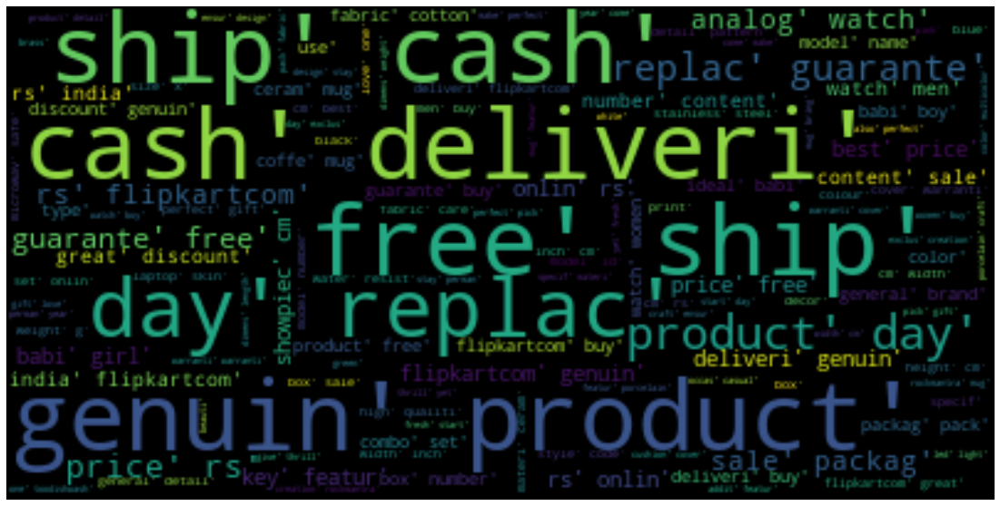

In [132]:
#representattion des mots les plus frequents et moins fréquents 
stopwords = set(words_to_delete)
corpus=data_nlp['description_stem']
wordcloud = WordCloud(stopwords=stopwords, background_color="BLACK")
text="".join(map(str, corpus)) 
wordcloud.generate(text)
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.imshow(wordcloud, interpolation='bilinear')

plt.axis('off')

plt.show()

In [133]:
import nltk
stopwords = set(words_to_delete)#dictionnaire de mots a supprimer
def suppression_word(text) :
    text=[mot for mot in text if mot not in stopwords]
    return text

## Analyse exploratoire après nettoyage

In [134]:
stats, freq = dict(), dict()
for k, v in data_nlp['description_final'].iteritems():
    freq[k] = fq = nltk.FreqDist(v)
    stats[k] = {'total': len(v)} 
# Premièrement, on récupère la fréquence totale de chaque mot sur tout le corpus d'artistes
freq_totale = nltk.Counter()
for k, v in data_nlp['description_final'].iteritems():
    freq_totale += freq[k]

In [135]:
freq_totale.keys()

dict_keys(['door', 'price', 'qualiti', 'metal', 'room', 'beauti', 'bring', 'light', 'right', 'general', 'type', 'dimens', 'box', 'cotton', 'yellow', 'inch', 'care', 'dri', 'bedsheet', 'cover', 'nice', 'thread', 'time', 'buy', 'flipkartcom', 'deliveri', 'whether', 'work', 'finish', 'azan', 'black', 'rang', 'execut', 'brilliant', 'hous', 'skmei', 'fba', 'dgred', 'steel', 'seri', 'resistantnight', 'duvet', 'thrade', 'riva', 'money', 'utensil', 'show', 'alloy', 'simpl', 'microwav', 'new', 'pyjama', 'neck', '°fstorag', 'outdoor', 'casserolecookart', 'perfect', 'vaniti', 'scienc', 'resolut', 'combin', 'gorgeous', 'superior', 'check', 'wooden', 'showpiec', 'medium', 'instal', 'thnkss…specif', 'bedroom', 'simul', 'sit', 'vaishnava', 'repouss��', 'four', 'roll', 'figurin', 'fill', 'mini', 'printer', 'screwincraftcart', 'svayam', 'ensur', 'leaf', 'warm', 'wild', 'stone', 'paper', 'flipkart', 'relat', 'anod', 'kadhai', 'marbl', 'dish', 'wok', '�to', 'prices�', 'layer', 'head', 'brahmz', 'raglan',

In [136]:
data_corpus=pd.DataFrame({'mots':freq_totale.keys(),'Frequence':freq_totale.values()})
data_corpus.head()

,mots,Frequence
0,door,39
1,price,557
2,qualiti,242
3,metal,29
4,room,69


Text(0.5, 1.0, 'La fréquence maximale du corpus')

<Figure size 1440x720 with 0 Axes>

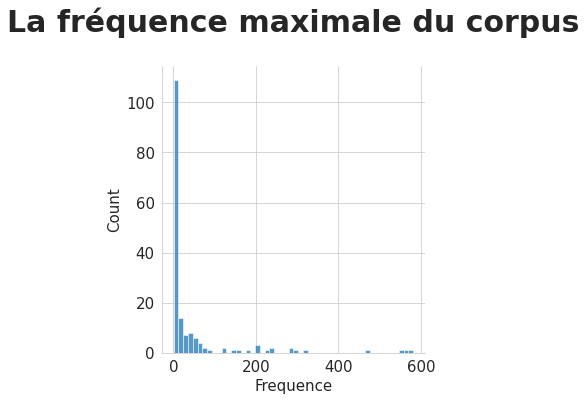

In [137]:
plt.figure(figsize=(20,10))
sns.displot(data=data_corpus,bins=50, x="Frequence");
plt.title('La fréquence maximale du corpus', fontsize = 30, pad = 35, fontweight = 'bold')

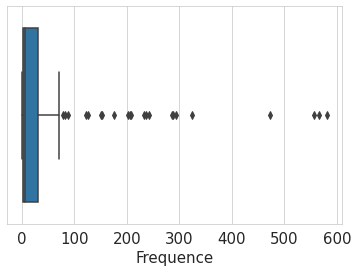

In [138]:
# Visualisation de boxplot
sns.boxplot(data=data_corpus,x='Frequence');

In [139]:
# Description statistique
data_corpus['Frequence'].describe()

count    170.000000
mean      43.782353
std      100.423922
min        1.000000
25%        2.000000
50%        6.000000
75%       29.750000
max      581.000000
Name: Frequence, dtype: float64

In [140]:
data_nlp['description_final']

0       [door, door, price, qualiti, metal, room, beau...
1       [cotton, yellow, cotton, general, type, cotton...
2       [cotton, inch, cotton, price, bring, cotton, q...
3       [cotton, bedsheet, bedsheet, cotton, bedsheet,...
4       [cotton, bedsheet, cotton, bedsheet, cover, pr...
                              ...                        
1045    [price, d�cor, simpl, instal, paper, instal, d...
1046    [price, bring, qualiti, ensur, receiv, qualiti...
1047                               [buy, price, deliveri]
1048               [buy, medium, medium, price, deliveri]
1049                               [buy, price, deliveri]
Name: description_final, Length: 1050, dtype: object

## Suppression des mots avec deux lettres et une lettre

In [141]:
stop=[w for w in data_corpus['mots'] if len(w) <= 2]
len(stop)

0

In [142]:
import nltk
stopwords = set(stop)#dictionnaire de mots a supprimer
def suppression_word(text) :
    text=[mot for mot in text if mot not in stopwords]
    return text

In [143]:
data_nlp['description_fin']=data_nlp['description_final1']
taille_mot(data_nlp,'description_fin')

170

# Bag of words

Le modèle de sac de mots (BoW) est le moyen le plus simple d'extraire des caractéristiques du texte. BoW convertit le texte en matrice d'occurrence de mots dans un document. Ce modèle concerne le fait que des mots donnés apparaissent ou non dans le document.

Récupérer la fréquence d'apparition de chaque mot dans une matrice avec ces différents paramètres en utilisant CountVectorizer de scikit-learn.

In [144]:
from sklearn.feature_extraction.text import CountVectorizer

corpus=data_nlp['description_fin'].apply(lambda x: ','.join(x))
corpus

0       door,door,price,qualiti,metal,room,beauti,brin...
1       cotton,yellow,cotton,general,type,cotton,yello...
2       cotton,inch,cotton,price,bring,cotton,qualiti,...
3       cotton,bedsheet,bedsheet,cotton,bedsheet,bedsh...
4       cotton,bedsheet,cotton,bedsheet,cover,price,ni...
                              ...                        
1045    price,d�cor,simpl,instal,paper,instal,d�cor,si...
1046    price,bring,qualiti,ensur,receiv,qualiti,inch,...
1047                                                price
1048                                  medium,medium,price
1049                                                price
Name: description_fin, Length: 1050, dtype: object

In [145]:
# Istanciation du modèle avec les hyperparamètres
vectorizer = CountVectorizer(ngram_range=(1,1),analyzer = "word")
model_vectorizer = vectorizer.fit_transform(corpus)

In [146]:
# pour obtenir les noms des fonctionnalités
features_names = vectorizer.get_feature_names()
features_names

['accent',
 'access',
 'adaptor',
 'alloy',
 'anod',
 'asia',
 'azan',
 'ball',
 'balm',
 'beauti',
 'bedroom',
 'bedsheet',
 'black',
 'boreal',
 'box',
 'brahmz',
 'breathless',
 'brilliant',
 'bring',
 'care',
 'carrot',
 'casserolecookart',
 'check',
 'combin',
 'connector',
 'cor',
 'cotton',
 'cover',
 'crash',
 'depth',
 'dgred',
 'dimens',
 'dish',
 'door',
 'doraemon',
 'dri',
 'duvet',
 'elfani',
 'ensur',
 'everytim',
 'execut',
 'explod',
 'faux',
 'fba',
 'ferrari',
 'figurin',
 'fill',
 'finish',
 'flipkart',
 'flipkartcom',
 'folio',
 'four',
 'fstorag',
 'gender',
 'general',
 'gorgeous',
 'head',
 'henc',
 'hgfvsimstmrn',
 'hous',
 'ibctdc',
 'inch',
 'inchesmkb',
 'indha',
 'instal',
 'kadhai',
 'karbonn',
 'kensington',
 'languag',
 'laptop',
 'layer',
 'leaf',
 'light',
 'lpln',
 'manual',
 'marbl',
 'medium',
 'metal',
 'microwav',
 'milton',
 'mini',
 'mnbt',
 'money',
 'multipurpos',
 'nearest',
 'necessari',
 'neck',
 'needybe',
 'neoclass',
 'new',
 'nice',
 'n

In [147]:
# Convertir la matrice sparce en tableau numpy
dense = model_vectorizer.todense()
dense

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 2, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]])

In [148]:
# Convertir un tableau en liste
denselist = dense.tolist()
denselist

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  5,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  2,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],
 [0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  3,
  0,
  0,
  0,
  0,
  1,

In [149]:
# Convertir en Dataframe
bow_vect = pd.DataFrame(denselist, columns= features_names)
bow_vect.sample(5)

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,whether,wild,wok,wooden,work,yellow,zipexterior,zyxel
849,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0
495,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0
1024,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0
791,0,0,0,0,0,0,0,0,...,0,2,0,0,0,0,0,0
767,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0


In [150]:
# Description statistique
bow_vect.describe().T

,count,mean,std,min,25%,50%,75%,max
accent,1050.0,0.003810,0.087246,0.0,0.0,0.0,0.0,2.0
access,1050.0,0.001905,0.043623,0.0,0.0,0.0,0.0,1.0
adaptor,1050.0,0.008571,0.154139,0.0,0.0,0.0,0.0,4.0
alloy,1050.0,0.002857,0.068980,0.0,0.0,0.0,0.0,2.0
anod,1050.0,0.001905,0.061721,0.0,0.0,0.0,0.0,2.0
...,...,...,...,...,...,...,...,...
wooden,1050.0,0.041905,0.395586,0.0,0.0,0.0,0.0,8.0
work,1050.0,0.037143,0.253764,0.0,0.0,0.0,0.0,2.0
yellow,1050.0,0.048571,0.373736,0.0,0.0,0.0,0.0,6.0
zipexterior,1050.0,0.000952,0.030861,0.0,0.0,0.0,0.0,1.0


In [151]:
bow_vect.shape

(1050, 168)

In [152]:
data_bow=pd.DataFrame({'Mots Frequents': bow_vect.max().sort_values(ascending=False).index,'Total':bow_vect.max().sort_values(ascending=False).values})
data_bow.sample(5)

,Mots Frequents,Total
142,zipexterior,1
39,roll,4
115,flipkartcom,2
125,alloy,2
48,balm,4


Text(0.5, 1.0, 'Les 20 mots qui apparaissent le plus selon BOW comptage simple')

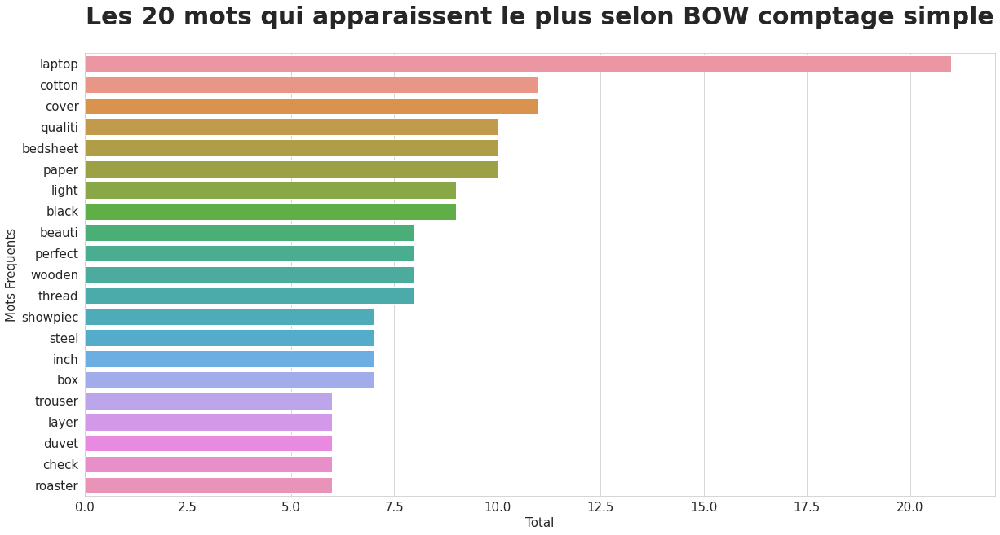

In [153]:
# les 30mots les plus frequents 
data_count = data_bow.loc[0:20,['Mots Frequents','Total']] 
plt.figure(figsize=(20,10))
sns.barplot(y='Mots Frequents',x='Total',data=data_count.sort_values('Total',ascending=False))
plt.title('Les 20 mots qui apparaissent le plus selon BOW comptage simple', fontsize = 30, pad = 35, fontweight = 'bold')

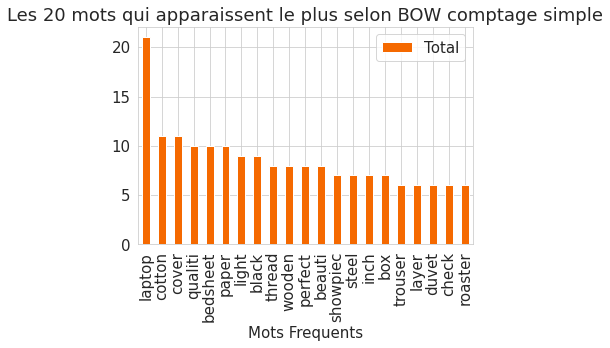

In [154]:
data_count.plot(kind='bar',x='Mots Frequents',y='Total', color="#f56900",title='Les 20 mots qui apparaissent le plus selon BOW comptage simple')

# TF-IDF (Terme Frequency-Inverse Document Frequency

Convertissez une collection de documents bruts en une matrice de fonctionnalités TF-IDF. Nous appelons vectorisation le processus général de transformation d'une collection de documents texte en vecteurs de caractéristiques numériques.

TFIDF est une approche bag-of-words (bow) permettant de représenter les mots d’un document à l’aide d’une matrice de nombres.TFIDF est une méthode efficace utilisée dans de nombreux outils de querying puisqu’elle donne de l’importance aux mots qui apparaissent de temps en temps mais pas trop, tout en en limitant l’importance des mots qui apparaissent souvent.

In [155]:
# Instanciation du model avec les hyperparamètres
tf_idf=TfidfVectorizer (analyzer='word', stop_words= 'english',ngram_range=(1,1))

# Entrainer et transformer le modèle
tfidf_mat=tf_idf.fit_transform(corpus)

In [156]:
# pour obtenir les noms des fonctionnalités
features_names = tf_idf.get_feature_names()
features_names

['accent',
 'access',
 'adaptor',
 'alloy',
 'anod',
 'asia',
 'azan',
 'ball',
 'balm',
 'beauti',
 'bedroom',
 'bedsheet',
 'black',
 'boreal',
 'box',
 'brahmz',
 'breathless',
 'brilliant',
 'bring',
 'care',
 'carrot',
 'casserolecookart',
 'check',
 'combin',
 'connector',
 'cor',
 'cotton',
 'cover',
 'crash',
 'depth',
 'dgred',
 'dimens',
 'dish',
 'door',
 'doraemon',
 'dri',
 'duvet',
 'elfani',
 'ensur',
 'everytim',
 'execut',
 'explod',
 'faux',
 'fba',
 'ferrari',
 'figurin',
 'finish',
 'flipkart',
 'flipkartcom',
 'folio',
 'fstorag',
 'gender',
 'general',
 'gorgeous',
 'head',
 'henc',
 'hgfvsimstmrn',
 'hous',
 'ibctdc',
 'inch',
 'inchesmkb',
 'indha',
 'instal',
 'kadhai',
 'karbonn',
 'kensington',
 'languag',
 'laptop',
 'layer',
 'leaf',
 'light',
 'lpln',
 'manual',
 'marbl',
 'medium',
 'metal',
 'microwav',
 'milton',
 'mini',
 'mnbt',
 'money',
 'multipurpos',
 'nearest',
 'necessari',
 'neck',
 'needybe',
 'neoclass',
 'new',
 'nice',
 'nikunj',
 'nois',
 

In [157]:
# Convertir la matrice sparce en tableau numpy
dense = tfidf_mat.todense()
dense

matrix([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.59654275, 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        ...,
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ]])

In [158]:
# Convertir un tableau en liste
denselist = dense.tolist()
denselist

[[0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.1273610707910369,
  0.0,
  0.0,
  0.0,
  0.0,
  0.08318970373044253,
  0.0,
  0.0,
  0.0,
  0.14687693864333168,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.10102818634282631,
  0.0,
  0.8573750482234272,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.07884434427678255,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.13214172135285152,
  0.0,
  0.0,
  0.0,
  0.0,
  0.17527955676203,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.05679468196902973,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.11299968965574969,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.17956084564162633,
  0.0,
  0

In [159]:
# Convertir en Dataframe
tfidf_vect = pd.DataFrame(denselist, columns= features_names)
tfidf_vect.sample(5)

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,warm,wild,wok,wooden,work,yellow,zipexterior,zyxel
16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
192,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
195,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
935,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
566,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Comme vous pouvez le constater, nous ne voyons ici que des zéros, ce qui est normal puisque sur ces 191 tokens, seuls quelques-uns sont présent dans chaque description.

In [160]:
tfidf_vect.shape

(1050, 163)

In [161]:
# Description statistique
tfidf_vect.describe().T

,count,mean,std,min,25%,50%,75%,max
accent,1050.0,0.000768,0.018122,0.0,0.0,0.0,0.0,0.503400
access,1050.0,0.000604,0.017388,0.0,0.0,0.0,0.0,0.558447
adaptor,1050.0,0.002643,0.045522,0.0,0.0,0.0,0.0,0.883900
alloy,1050.0,0.001068,0.026855,0.0,0.0,0.0,0.0,0.814540
anod,1050.0,0.000790,0.025596,0.0,0.0,0.0,0.0,0.829404
...,...,...,...,...,...,...,...,...
wooden,1050.0,0.008673,0.075954,0.0,0.0,0.0,0.0,0.947627
work,1050.0,0.007886,0.058895,0.0,0.0,0.0,0.0,0.735748
yellow,1050.0,0.013613,0.097067,0.0,0.0,0.0,0.0,0.941018
zipexterior,1050.0,0.000563,0.018253,0.0,0.0,0.0,0.0,0.591460


In [162]:
data_tf=pd.DataFrame({'Mots Frequents': tfidf_vect.max().sort_values(ascending=False).index,'Total':tfidf_vect.max().sort_values(ascending=False).values})
data_tf.sample(5)

,Mots Frequents,Total
140,outdoor,0.510525
91,dish,0.828000
8,everytim,0.993533
21,trouser,0.988570
99,uhd,0.787161


Text(0.5, 1.0, 'Les 20 mots qui apparaissent avec la fréquence TF-IDF la plus élevée')

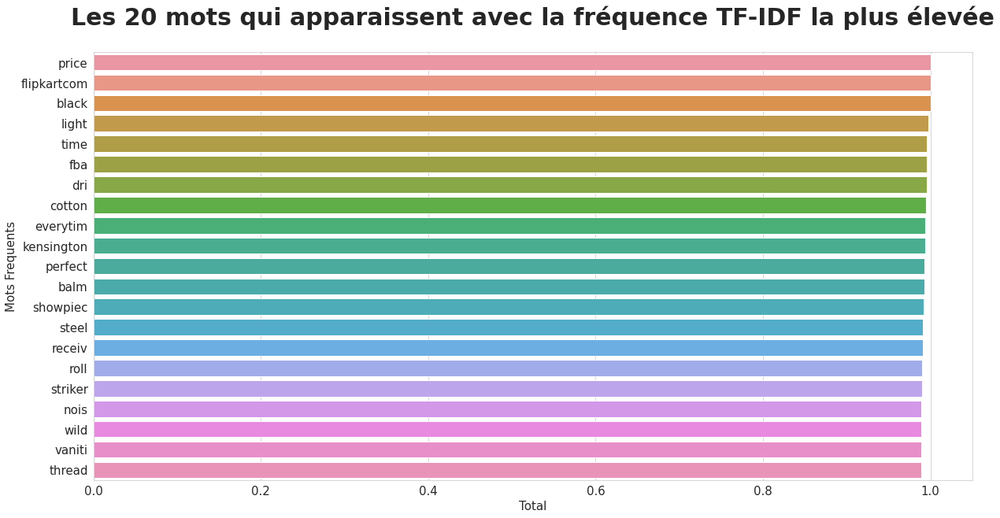

In [163]:
# les 30mots les plus frequents 
data_tfidf = data_tf.loc[0:20,['Mots Frequents','Total']] 
plt.figure(figsize=(20,10))
sns.barplot(y='Mots Frequents',x='Total',data=data_tfidf.sort_values('Total',ascending=False))
plt.title('Les 20 mots qui apparaissent avec la fréquence TF-IDF la plus élevée', fontsize = 30, pad = 35, fontweight = 'bold')

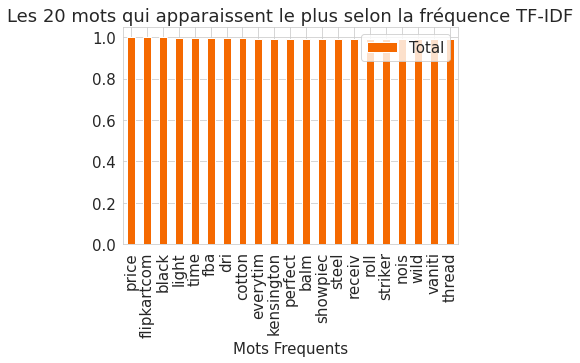

In [164]:
data_tfidf.plot(kind='bar',x='Mots Frequents',y='Total', color="#f56900",title='Les 20 mots qui apparaissent le plus selon la fréquence TF-IDF')

# Ignorer les décomptes et utiliser des valeurs binaires

Par défaut, CountVectorizer utilise le nombre de termes/jetons. Cependant, vous pouvez choisir d'utiliser uniquement la présence ou l'absence d'un terme au lieu des décomptes bruts. Ceci est utile dans certaines tâches telles que certaines fonctionnalités de classification de texte où la fréquence d'occurrence est insignifiante. Pour obtenir des valeurs binaires au lieu de nombres, tout ce que vous avez à faire est de définir binary=True.

Si vous définissez binary=Truealors CountVectorizer n'utilise plus le nombre de termes/jetons. Si un jeton est présent dans un document, il vaut 1, s'il est absent il l'est 0quelle que soit sa fréquence d'occurrence. Par défaut, binary=False.

In [165]:
# Instanciation du modèle
vectorizer = CountVectorizer(binary='true')

# Entrainer et transformé les données
count_vectorizer = vectorizer.fit_transform(corpus)

In [166]:
# pour obtenir les noms des fonctionnalités
features_names = vectorizer.get_feature_names()
features_names

['accent',
 'access',
 'adaptor',
 'alloy',
 'anod',
 'asia',
 'azan',
 'ball',
 'balm',
 'beauti',
 'bedroom',
 'bedsheet',
 'black',
 'boreal',
 'box',
 'brahmz',
 'breathless',
 'brilliant',
 'bring',
 'care',
 'carrot',
 'casserolecookart',
 'check',
 'combin',
 'connector',
 'cor',
 'cotton',
 'cover',
 'crash',
 'depth',
 'dgred',
 'dimens',
 'dish',
 'door',
 'doraemon',
 'dri',
 'duvet',
 'elfani',
 'ensur',
 'everytim',
 'execut',
 'explod',
 'faux',
 'fba',
 'ferrari',
 'figurin',
 'fill',
 'finish',
 'flipkart',
 'flipkartcom',
 'folio',
 'four',
 'fstorag',
 'gender',
 'general',
 'gorgeous',
 'head',
 'henc',
 'hgfvsimstmrn',
 'hous',
 'ibctdc',
 'inch',
 'inchesmkb',
 'indha',
 'instal',
 'kadhai',
 'karbonn',
 'kensington',
 'languag',
 'laptop',
 'layer',
 'leaf',
 'light',
 'lpln',
 'manual',
 'marbl',
 'medium',
 'metal',
 'microwav',
 'milton',
 'mini',
 'mnbt',
 'money',
 'multipurpos',
 'nearest',
 'necessari',
 'neck',
 'needybe',
 'neoclass',
 'new',
 'nice',
 'n

In [167]:
# Convertir la matrice sparce en tableau numpy
dense = count_vectorizer.todense()
dense

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 1, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]])

In [168]:
# Convertir un tableau en liste
denselist = dense.tolist()
denselist

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],
 [0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  1,

In [169]:
# Convertir en Dataframe
count_vect = pd.DataFrame(denselist, columns= features_names)
count_vect.sample(5)

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,whether,wild,wok,wooden,work,yellow,zipexterior,zyxel
487,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0
612,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0
771,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0
893,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0
523,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0


In [170]:
count_vect.shape

(1050, 168)

In [171]:
# Description statistique
count_vect.describe().T

,count,mean,std,min,25%,50%,75%,max
accent,1050.0,0.001905,0.043623,0.0,0.0,0.0,0.0,1.0
access,1050.0,0.001905,0.043623,0.0,0.0,0.0,0.0,1.0
adaptor,1050.0,0.003810,0.061633,0.0,0.0,0.0,0.0,1.0
alloy,1050.0,0.001905,0.043623,0.0,0.0,0.0,0.0,1.0
anod,1050.0,0.000952,0.030861,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...
wooden,1050.0,0.016190,0.126268,0.0,0.0,0.0,0.0,1.0
work,1050.0,0.022857,0.149519,0.0,0.0,0.0,0.0,1.0
yellow,1050.0,0.022857,0.149519,0.0,0.0,0.0,0.0,1.0
zipexterior,1050.0,0.000952,0.030861,0.0,0.0,0.0,0.0,1.0


# Réduction dimensionnelle - PCA

In [172]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Les données
n_comp = 0.95
X = count_vect.values
features=count_vect.columns

# Modèle PCA
pca = PCA(n_components=0.95)
# Entrainer le modèle
data_pca = pca.fit(X)
# Différents composantes
pcs = pca.components_

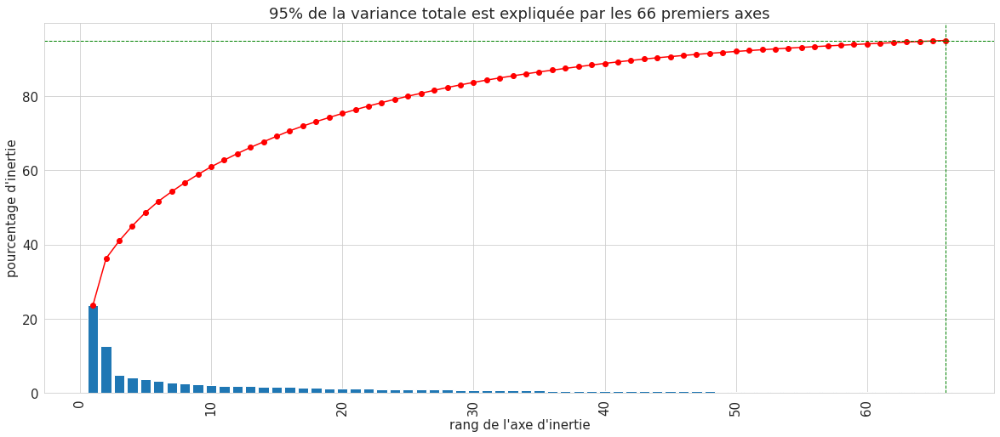

In [173]:
# Variance expliquée
varexpl = pca.explained_variance_ratio_*100

# Graphique de la variance cumulée
plt.figure(figsize=(20,8))
plt.bar(np.arange(len(varexpl))+1, varexpl)

# Somme des variances
cumSumVar = varexpl.cumsum()
plt.plot(np.arange(len(varexpl))+1, cumSumVar, c = "red",marker = 'o')
plt.axhline(y = 95, linestyle="--", color="green",linewidth=1)

limit = 95
valid_idx = np.where(cumSumVar >= limit)[0]
min_plans = valid_idx[cumSumVar[valid_idx].argmin()]+1
plt.axvline(x=min_plans, linestyle="--", 
            color="green",
            linewidth=1)

plt.xticks(rotation=90)
plt.xlabel("rang de l'axe d'inertie")
#plt.xticks(np.arange(len(varexpl))+1)
plt.ylabel("pourcentage d'inertie")
plt.title("{}% de la variance totale est expliquée"\
          " par les {} premiers axes".format(limit,
                                            min_plans))
plt.show(block=False)

In [174]:
sum_pca = np.cumsum(pca.explained_variance_ratio_)
for counter, value in enumerate(sum_pca):
    if value > 0.95:
        data_reduced = pca.transform(X)[:,:counter]
        break

In [175]:
def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    for d1, d2 in axis_ranks: # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(10,10))

            # détermination des limites du graphique
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color="grey")
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
            
            # affichage des noms des variables  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.5)
            
            # affichage du cercle
            an = np.linspace(0, 2 * np.pi, 100)  # Ajoutez un cercle d'unité pour l'échelle
            plt.plot(np.cos(an), np.sin(an))
            plt.axis('equal')

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)

In [176]:
# Appel à la fonction
display_circles(pcs, n_comp, pca, [(0,1),(2,3)], labels = np.array(features))

In [177]:
# Aprés réduction de dimension
data_reduced

array([[ 1.73055158e+00, -9.24902641e-02,  8.44526490e-01, ...,
         1.19829018e-01, -2.76033854e-01, -1.36130435e-03],
       [ 1.40842010e+00,  1.07902938e+00, -2.78362054e-01, ...,
        -3.42776225e-02,  7.14359091e-02,  2.28144669e-02],
       [ 2.01526812e+00,  3.15896567e-01, -1.99910687e-01, ...,
         2.88178798e-02,  3.21290574e-02,  3.41935508e-02],
       ...,
       [-1.58997039e-01, -6.59952518e-01, -1.68460568e-01, ...,
         1.12982421e-03, -7.52376894e-03,  1.75847908e-02],
       [-1.43542431e-01, -6.65780720e-01, -1.71420423e-01, ...,
        -7.20644711e-03,  3.57613623e-02,  4.19019429e-02],
       [-1.58997039e-01, -6.59952518e-01, -1.68460568e-01, ...,
         1.12982421e-03, -7.52376894e-03,  1.75847908e-02]])

In [178]:
print('nombre de features : {}, variance : {}'.format(counter+1,
                np.cumsum(pca.explained_variance_ratio_)[counter]))


nombre de features : 66, variance : 0.9512765691296852


In [179]:
# Aprés réduction de dimension
data_reduced.shape

(1050, 65)

In [180]:
# première composantes
data_reduced[:,0].max()

2.3008766493655792

In [181]:
# Deuxième composantes
data_reduced[:,1].max()

1.216506197174894

D'après ces résultats on voit qu'il n'est pertinent la projection sur les deux axes.

In [182]:
data_reduced.shape,count_vect.shape

((1050, 65), (1050, 168))

Après réduction de dimension, on passe de 222 features à 92 features

In [183]:
# Création du dataframe de la réduction de dimension
data_pca = pd.DataFrame({
    "PCA1" : data_reduced[:,0], 
    "PCA2" : data_reduced[:,1]})
data_pca.head()

,PCA1,PCA2
0,1.730552,-0.092490
1,1.408420,1.079029
2,2.015268,0.315897
3,1.671471,1.216506
4,2.130199,0.412267


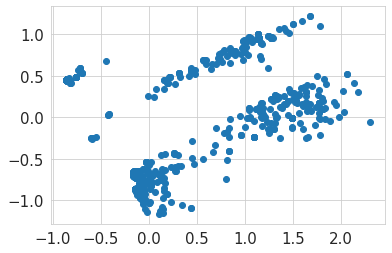

In [184]:
# Visualisation
plt.scatter(data_reduced[:,0],data_reduced[:,1])

Text(0.5, 0.98, 'Premier plan factoriel')

<Figure size 1080x1080 with 0 Axes>

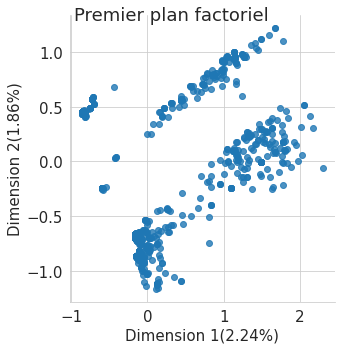

In [185]:
#Affichage de nos corpus sur les premiers axes
#de la projection
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x='PCA1', y='PCA2',data=data_pca,fit_reg = False)
g_pca.set(xlabel = "Dimension 1(2.24%)", ylabel = "Dimension 2(1.86%)")
g_pca.fig.suptitle("Premier plan factoriel")

# Création des clusters

## Nombre optimal de clusters

In [186]:
#!pip install yellowbrick

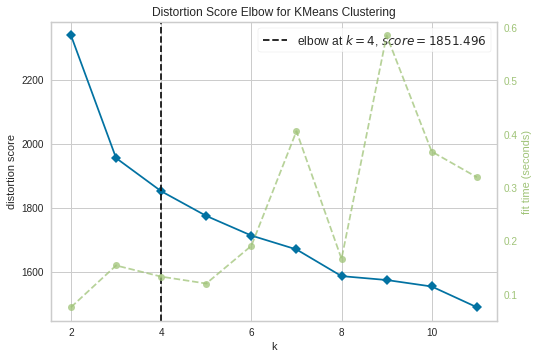

In [187]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
from sklearn import metrics, cluster
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer


# Instancier le modèle de clustering et le visualiseur
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,12))

visualizer.fit(data_reduced)        # Adapter les données au visualiseur
visualizer.show();      # Finaliser et rendre la figure

## Essayons d'autres méthodes pour le nombre de clusters

Nous pouvons utiliser la méthode du coude pour tester différentes valeurs de K et comparer les distances de chaque point de données à leurs centroïdes (la somme des erreurs au carré ou WCSS).

Ensuite, j'ai tracé la somme des carrés dans le cluster (WCSS) par rapport au nombre de clusters (valeur K) pour déterminer le nombre optimal de valeurs de clusters. WCSS mesure la somme des distances des observations à partir de leurs centroïdes de cluster qui est donnée par la formule ci-dessous.

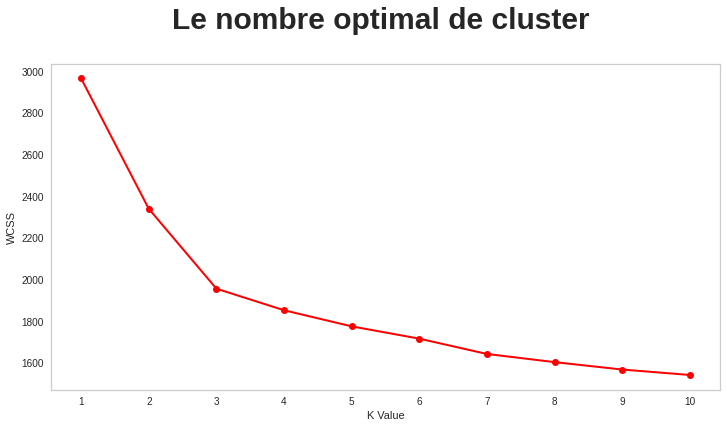

In [188]:
from sklearn.cluster import KMeans
wcss = []
for k in range(1,11):
    kmeans_model = KMeans(n_clusters=k, init="k-means++")
    kmeans_model.fit(data_reduced)
    wcss.append(kmeans_model.inertia_)
plt.figure(figsize=(12,6))    
plt.grid()
plt.plot(range(1,11),wcss, linewidth=2, color="red", marker ="o")
plt.xlabel("K Value")
plt.xticks(np.arange(1,11,1))
plt.ylabel("WCSS")
plt.title('Le nombre optimal de cluster ', fontsize = 30, pad = 35, fontweight = 'bold')
plt.show()

Le point de coude semble être à 7. La baisse de WCSS après ce point commence à devenir de plus en plus faible.

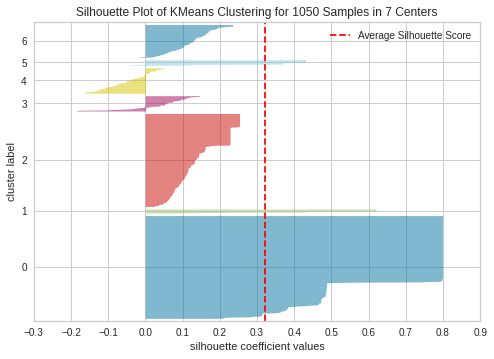

In [189]:
from yellowbrick.cluster import SilhouetteVisualizer

# Instancier le modèle de clustering et le visualiseur
model = KMeans(7, random_state=0)
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(data_reduced)        # Adapter les données au visualiseur
visualizer.show()

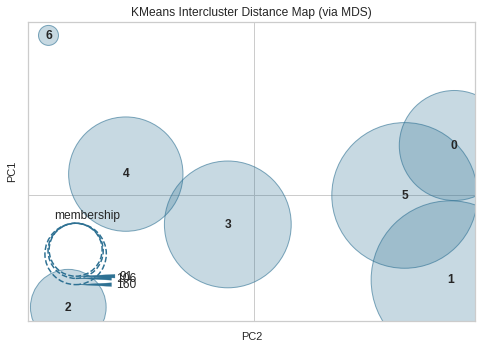

In [190]:
from yellowbrick.cluster import InterclusterDistance

# Instancier le modèle de clustering et le visualiseur
model = KMeans(7)
visualizer = InterclusterDistance(model)

visualizer.fit(data_reduced)        # Adapter les données au visualiseur
visualizer.show()        # Finaliser et rendre la figure

### Evaluation du score silhouette

In [191]:
from sklearn.metrics import silhouette_score
silhouette_score(data_reduced, labels=kmeans_model.predict(data_reduced))

0.295449819332694

Cette valeur signifie donc que nos clusters se chevauchent. Nous pouvons également le voir dans le graphique ci-dessous.

### Commençons ici et testons K = 6

In [192]:
#Create 6 clusters
kmeans_model1 = KMeans(n_clusters=6)
kmeans_model1.fit(data_reduced)
kmeans_model1.predict(data_reduced)

array([3, 2, 3, ..., 0, 0, 0], dtype=int32)

In [193]:
# Kmeans labels
kmeans_label = pd.DataFrame(kmeans_model1.labels_)

In [194]:
# Ajouter la nouvelle colonne 
count_vect["cluster"] = kmeans_label
count_vect.head()

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,wild,wok,wooden,work,yellow,zipexterior,zyxel,cluster
0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3
1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,2
2,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3
3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,4
4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3


In [195]:
# grouper par cluster
kmeans_clusters_means1 = count_vect.groupby("cluster").mean()
kmeans_clusters_means1

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,whether,wild,wok,wooden,work,yellow,zipexterior,zyxel
cluster,,,,,,,,,,,,,,,,,
0,0.005479,0.000000,0.008219,0.002740,0.00274,0.000000,0.000000,0.000000,...,0.002740,0.010959,0.00274,0.027397,0.041096,0.027397,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.005155,0.000000,...,0.000000,0.010309,0.00000,0.000000,0.000000,0.010309,0.000000,0.007732
2,0.000000,0.009259,0.009259,0.000000,0.00000,0.000000,0.000000,0.009259,...,0.000000,0.000000,0.00000,0.018519,0.018519,0.037037,0.009259,0.000000
3,0.000000,0.012346,0.000000,0.012346,0.00000,0.012346,0.000000,0.012346,...,0.012346,0.012346,0.00000,0.061728,0.086420,0.037037,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.012658,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.037975,0.000000,0.000000
5,0.000000,0.000000,0.000000,0.000000,0.00000,0.034483,0.000000,0.000000,...,0.034483,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000


### Testons K = 7

In [196]:
#Create 7 clusters
kmeans_model2 = KMeans(n_clusters=7)
kmeans_model2.fit(data_reduced)
kmeans_model2.predict(data_reduced)

array([1, 6, 1, ..., 3, 3, 3], dtype=int32)

In [197]:
# Kmeans labels
kmeans_label = pd.DataFrame(kmeans_model2.labels_)
# Ajouter la nouvelle colonne 
count_vect["cluster"] = kmeans_label
count_vect.head()

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,wild,wok,wooden,work,yellow,zipexterior,zyxel,cluster
0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1
1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,6
2,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1
3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2
4,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1


In [198]:
# grouper par cluster
kmeans_clusters_means2 = count_vect.groupby("cluster").mean()
kmeans_clusters_means2

,accent,access,adaptor,alloy,anod,asia,azan,ball,...,whether,wild,wok,wooden,work,yellow,zipexterior,zyxel
cluster,,,,,,,,,,,,,,,,,
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.005128,0.000000,...,0.000000,0.010256,0.000000,0.000000,0.000000,0.010256,0.000000,0.007692
1,0.000000,0.012987,0.000000,0.012987,0.000000,0.012987,0.000000,0.012987,...,0.012987,0.012987,0.000000,0.064935,0.077922,0.038961,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.011765,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.035294,0.000000,0.000000
3,0.007194,0.000000,0.010791,0.000000,0.003597,0.000000,0.000000,0.000000,...,0.003597,0.014388,0.003597,0.000000,0.039568,0.021583,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,0.000000,0.000000,0.000000,0.010989,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.109890,0.043956,0.043956,0.000000,0.000000
6,0.000000,0.008197,0.008197,0.000000,0.000000,0.008197,0.000000,0.008197,...,0.008197,0.000000,0.000000,0.016393,0.024590,0.032787,0.008197,0.000000


# Visualisation à l'aide de TSNE et PCA 

t-Distributed Stochastic Neighbor Embedding ( t-SNE ) est une autre technique de réduction de la dimensionnalité et est particulièrement bien adaptée à la visualisation d'ensembles de données de grande dimension. Contrairement à l'ACP, ce n'est pas une technique mathématique mais probabiliste.

In [199]:
from sklearn.manifold import TSNE
import time

time_start = time.time()
tsne = TSNE(n_components=2, perplexity=5)
tsne_results = tsne.fit_transform(X)

print('t-SNE finie! Temps écoulé: {} seconds'.format(time.time()-time_start))

data_tsne = pd.DataFrame(tsne_results[:,0:2], columns=['tsne1', 'tsne2'])
print(data_tsne.shape)

t-SNE finie! Temps écoulé: 6.017406463623047 seconds
(1050, 2)


In [200]:
data_tsne.head(5)

,tsne1,tsne2
0,14.601677,47.587261
1,-17.243259,64.459343
2,-12.454210,51.283184
3,-11.975288,54.369686
4,-13.046299,54.287426


Maintenant que nous avons les deux dimensions résultantes, nous pouvons à nouveau les visualiser en créant un nuage de points des deux dimensions et en colorant chaque échantillon par son étiquette respective.

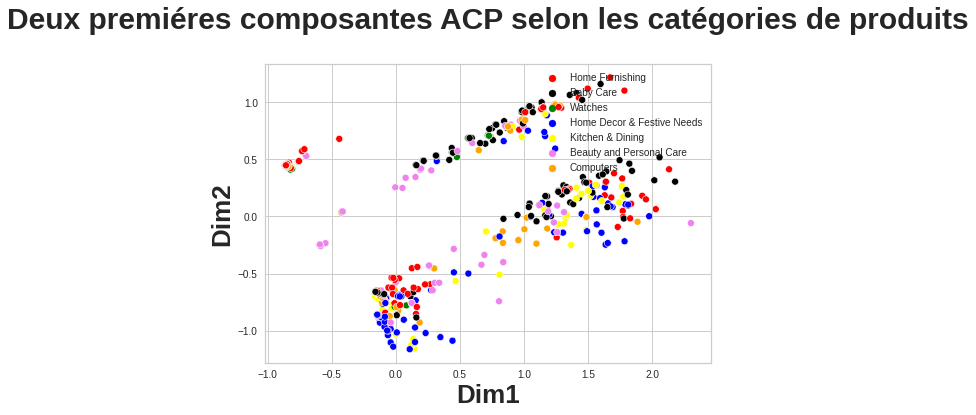

In [201]:
# Graphe avec les catégories en fonction des deux composantes
plt.figure()
pal = ['red', 'black', 'green', 'blue', 'yellow', 'violet','orange']
sns.scatterplot(y='PCA2', x='PCA1', hue=data_nlp['cat_lvl_1'],
                    palette=pal, data=data_pca)
plt.title('Deux premiéres composantes ACP selon les catégories de produits', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('Dim1', fontsize = 26, fontweight = 'bold')
plt.ylabel('Dim2', fontsize = 26, fontweight = 'bold')
plt.legend(loc='upper right')

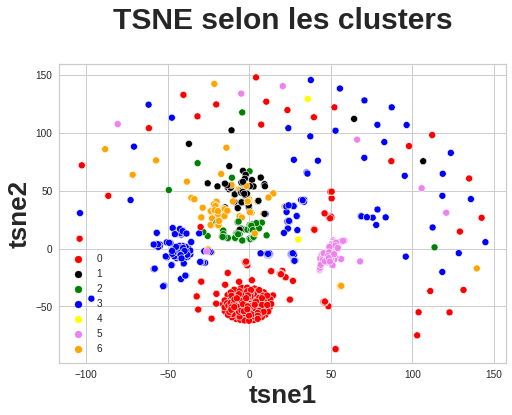

In [202]:
#graphe des clusters en fonction des deux premieres composantes de l'acp
plt.figure()
pal = ['red', 'black', 'green', 'blue', 'yellow', 'violet','orange']
sns.scatterplot(y='tsne2', x='tsne1', hue=count_vect["cluster"],
                    palette=pal, data=data_tsne)
plt.title('TSNE selon les clusters', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend(loc="lower left") 

plt.show()

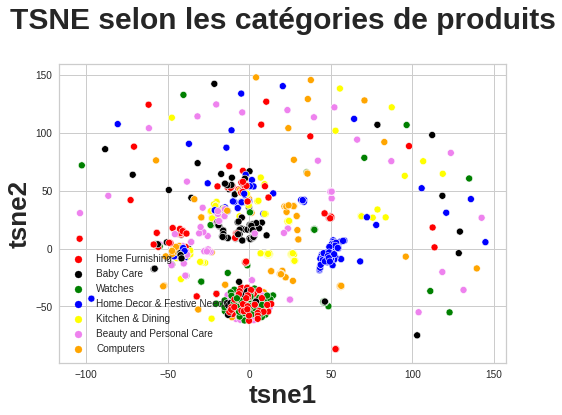

In [203]:
#graphe des clusters en fonction des deux premieres composantes de l'acp
plt.figure()
pal = ['red', 'black', 'green', 'blue', 'yellow', 'violet','orange']
sns.scatterplot(y='tsne2', x='tsne1', hue=data_nlp['cat_lvl_1'],
                    palette=pal, data=data_tsne)
plt.title('TSNE selon les catégories de produits', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend(loc="lower left") 

plt.show()

## Evaluation de la stabilité de notre clustering

Nous allons evaluer la stabilité de notre clustering en fonction des catégories de produits en les transformant.

In [204]:
# Afficher les modalités de chaque catégorie
data_nlp['cat_lvl_1'].unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [205]:
# Afficher la somme totale de chaque modalité
data_nlp['cat_lvl_1'].value_counts()

Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: cat_lvl_1, dtype: int64

In [206]:
from sklearn.preprocessing import LabelEncoder

encoder=LabelEncoder()
encoder_model=encoder.fit_transform(data_nlp['cat_lvl_1'])
# afficher la transformation
encoder_model

array([4, 0, 0, ..., 0, 0, 0])

Utlisons le ARI qui est une mesure de similarité pour verifier la stablité 

In [207]:
from sklearn.metrics import adjusted_rand_score
# Calcul ARI score
ari = adjusted_rand_score(encoder_model,kmeans_model.labels_)
print(ari)

0.16553147012637567


Le score montre qu'il n y a pas de correspondance entre le nombre de cluster et les catéqories.

# Classement sur les données textuelles

## Préparation des données

In [208]:
# Préparation des données d'entrainement et données test
train, test = train_test_split(data_nlp, test_size= 0.25, random_state = 42)

In [209]:
# Sauvegarder les données
train.to_csv("data_nlp_train.csv")
test.to_csv("data_nlp_test.csv")

In [210]:
# Afficher les 3 premières lignes des données d'entrainement
train.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,...,description_nodg,description_token,description_stop,description_stem,description_stem1,description_final,description_final1,description_fin
165,785b4383b12106dd172306d427d8f7b2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/rockmantra-cute-two-ca...,Rockmantra Cute Two Cats Ceramic Mug,MUGEAGGKFBTYPN4Z,499.0,349.0,785b4383b12106dd172306d427d8f7b2.jpg,...,Rockmantra Cute Two Cats Ceramic Mug l\r\n ...,"[rockmantra, cute, two, cats, ceramic, mug, l,...","[rockmantra, cute, two, cats, ceramic, mug, l,...","[rockmantra, cute, two, cat, ceram, mug, l, pr...","[rockmantra, cute, two, cat, ceram, mug, price...","[price, ensur, perfect, microwav, ensur, perfe...","[price, ensur, perfect, microwav, ensur, perfe...","[price, ensur, perfect, microwav, ensur, perfe..."
248,45d0af2c709de47268c80c35a117de44,2015-12-01 12:40:44 +0000,http://www.flipkart.com/malhar-niko-male-doll-...,Malhar Niko Male Doll Showpiece - 25 cm,SHIEY382SR75SXEY,6395.0,5436.0,45d0af2c709de47268c80c35a117de44.jpg,...,Buy Malhar Niko Male Doll Showpiece cm for...,"[buy, malhar, niko, male, doll, showpiece, cm,...","[buy, malhar, niko, male, doll, showpiece, cm,...","[buy, malhar, niko, male, doll, showpiec, cm, ...","[buy, malhar, niko, male, doll, showpiec, onli...","[buy, showpiec, showpiec, price, deliveri]","[showpiec, showpiec, price]","[showpiec, showpiec, price]"
310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,RTRDZTF9DBT4CW8U,14999.0,13500.0,64b463dc0b75ae40a848498c657041e6.jpg,...,Buy Linksys Smart WiFi Router only for Rs fro...,"[buy, linksys, smart, wifi, router, only, for,...","[buy, linksys, smart, wifi, router, rs, flipka...","[buy, linksi, smart, wifi, router, rs, flipkar...","[buy, linksi, smart, wifi, router, flipkartcom...","[buy, flipkartcom, deliveri]",[flipkartcom],[flipkartcom]


In [211]:
# La forme des données test
train.shape

(787, 26)

In [212]:
# Afficher les 3 premières lignes des données test
test.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,...,description_nodg,description_token,description_stop,description_stem,description_stem1,description_final,description_final1,description_fin
352,833a87b0af3b84fe246d2ebf271af177,2015-12-01 06:13:00 +0000,http://www.flipkart.com/zyxel-pla-4205/p/itmdy...,Zyxel PLA-4205,RTRDYZYDXGHXXJNZ,10999.0,8100.0,833a87b0af3b84fe246d2ebf271af177.jpg,...,Buy Zyxel PLA only for Rs from Flipkartcom On...,"[buy, zyxel, pla, only, for, rs, from, flipkar...","[buy, zyxel, pla, rs, flipkartcom, genuine, pr...","[buy, zyxel, pla, rs, flipkartcom, genuin, pro...","[buy, zyxel, pla, flipkartcom, genuin, product...","[buy, zyxel, flipkartcom, deliveri]","[zyxel, flipkartcom]","[zyxel, flipkartcom]"
689,55195de3873fffaa9e37b041533d7305,2015-12-31 09:19:31 +0000,http://www.flipkart.com/philips-9-5-w-led-b22-...,Philips 9.5 W LED B22 3000K A55 IND Bulb,BLBEF3HEKYURWHKG,699.0,419.0,55195de3873fffaa9e37b041533d7305.jpg,...,Buy Philips W LED B K A IND Bulb for Rs onlin...,"[buy, philips, w, led, b, k, a, ind, bulb, for...","[buy, philips, w, led, b, k, ind, bulb, rs, on...","[buy, philip, w, led, b, k, ind, bulb, rs, onl...","[buy, philip, led, ind, bulb, onlin, philip, l...","[buy, price, deliveri]",[price],[price]
485,44b963eb856b4831dfdd21b666593c95,2016-01-07 05:50:25 +0000,http://www.flipkart.com/lapguard-lenovo-ideapa...,Lapguard Lenovo IdeaPad V470 6 Cell Laptop Bat...,ACCDVPGKY3GBDB5P,3999.0,1799.0,44b963eb856b4831dfdd21b666593c95.jpg,...,Lapguard Lenovo IdeaPad V Cell Laptop Battery...,"[lapguard, lenovo, ideapad, v, cell, laptop, b...","[lapguard, lenovo, ideapad, v, cell, laptop, b...","[lapguard, lenovo, ideapad, v, cell, laptop, b...","[lapguard, lenovo, ideapad, cell, laptop, batt...","[laptop, price, qualiti, qualiti, laptop, qual...","[laptop, price, qualiti, qualiti, laptop, qual...","[laptop, price, qualiti, qualiti, laptop, qual..."


In [213]:
# La forme des données test
test.shape

(263, 26)

In [214]:
train_data=train['description_fin'].apply(lambda x: ' '.join(x))
train_data

test_data=test['description_fin'].apply(lambda x: ' '.join(x))
test_data

# Istanciation du modèle
vect = CountVectorizer()
# Entrainer notre modèle sur la liste des descriptions
model_vector = vectorizer.fit_transform(train_data)
# Afficher le modèle
model_vector

<787x149 sparse matrix of type '<class 'numpy.int64'>'
	with 2841 stored elements in Compressed Sparse Row format>

In [215]:
train_data=train['description_fin'].apply(lambda x: ' '.join(x))
train_data

test_data=test['description_fin'].apply(lambda x: ' '.join(x))
test_data

# Istanciation du modèle
tfidf = TfidfVectorizer()   #analyzer='word', stop_words= 'english',ngram_range=(1,1)
# Entrainer notre modèle sur la liste des descriptions
tfidf_vector = vectorizer.fit_transform(train_data)
# Afficher le modèle
model_vector

<787x149 sparse matrix of type '<class 'numpy.int64'>'
	with 2841 stored elements in Compressed Sparse Row format>

# Exploration de modélisation de sujet avec LDA

La modélisation des sujets est le processus d'  utilisation de techniques d'apprentissage non supervisé pour extraire les principaux sujets qui se produisent dans une collection de documents.

Latent Dirichlet Allocation  (LDA) est un modèle facile à utiliser et efficace pour la modélisation de sujets. Chaque document est représenté par la distribution des sujets et chaque sujet est représenté par la distribution des mots.

## LDA (Latent Dirichlet Allocation)       

On peut ensuite utiliser les catégories de produits pour effectuer des recherches plus rapide avec l'algorithme LDA

#### Catégories 1

In [216]:
corpus=data_nlp['description_fin'].apply(lambda x: ' '.join(x))
corpus

# Istanciation du modèle
vectorizer = CountVectorizer()
# Entrainer notre modèle sur la liste des descriptions
model_vect = vectorizer.fit_transform(corpus)
# Afficher le modèle
model_vect

<1050x168 sparse matrix of type '<class 'numpy.int64'>'
	with 3852 stored elements in Compressed Sparse Row format>

In [217]:
from sklearn.decomposition import LatentDirichletAllocation

# Modèle
lda = LatentDirichletAllocation(n_components = data_nlp["cat_lvl_2"].nunique(),
                                random_state=2)
# fitter notre modèle à nos données sur les termes fréquency
lda.fit(model_vect)

LatentDirichletAllocation(n_components=62, random_state=2)

Création d'une fonction qui permet d'afficher les sujets à partir des mots qui ont plus de poids dans les catégories de produits

In [218]:
def display_topics(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()

In [219]:
# Associer chaque comptage à la valeur du mot(la chaine de caractères)
lda_features_names = vectorizer.get_feature_names()
# Appel à la fonction
display_topics(lda, lda_features_names, n_top_words = 10) # n_top_words = 10 les 10 mots les plus représentatif des catégorie

Topic #0: work price nice whether finish seth fba fstorag hgfvsimstmrn henc
Topic #1: multipurpos connector ensur price hous care general hgfvsimstmrn henc head
Topic #2: bring perfect qualiti beauti show price general hous hgfvsimstmrn henc
Topic #3: cotton care general price box dimens dri accent carrot type
Topic #4: show four utensil time inch karbonn henc head gorgeous general
Topic #5: stone wild price zyxel fstorag hgfvsimstmrn henc head gorgeous general
Topic #6: dri price care cotton zyxel general hous hgfvsimstmrn henc head
Topic #7: duvet beauti ensur crash price breathless swampi anod gorgeous ibctdc
Topic #8: inch dimens box type general cover price qualiti whether hgfvsimstmrn
Topic #9: pyjama trouser box price dish trader type general faux repouss
Topic #10: box vaniti thread price purpos dimens work beauti right gender
Topic #11: room price money supplier inch fill finish fba ferrari hous
Topic #12: medium room price sit bedroom type box general beauti dimens
Topic #13:

In [220]:
val_best_topic = {}
best_topic = {}
matrix = lda.transform(model_vect)
for i in range(0,matrix.shape[0]):
    val_best_topic[i] = 0
    for j in range(0, matrix.shape[1]):
        if matrix[i,j] > val_best_topic[i]:
            val_best_topic[i] = matrix[i,j]
            best_topic[i]= j

### Visualisation des topics

In [221]:
"""
%matplotlib inline
import plotly.express as px
def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(3, 2, figsize=(30, 15), sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[:-n_top_words - 1:-1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f'Topic {topic_idx +1}',
                     fontdict={'fontsize': 30})
        ax.invert_yaxis()
        ax.tick_params(axis='both', which='major', labelsize=20)
        for i in 'top right left'.split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)
    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.show()
    
#Show topics
n_top_words = 5
feature_names = vectorizer.get_feature_names()
plot_top_words(lda, feature_names, n_top_words, '')
"""

"\n%matplotlib inline\nimport plotly.express as px\ndef plot_top_words(model, feature_names, n_top_words, title):\n    fig, axes = plt.subplots(3, 2, figsize=(30, 15), sharex=True)\n    axes = axes.flatten()\n    for topic_idx, topic in enumerate(model.components_):\n        top_features_ind = topic.argsort()[:-n_top_words - 1:-1]\n        top_features = [feature_names[i] for i in top_features_ind]\n        weights = topic[top_features_ind]\n\n        ax = axes[topic_idx]\n        ax.barh(top_features, weights, height=0.7)\n        ax.set_title(f'Topic {topic_idx +1}',\n                     fontdict={'fontsize': 30})\n        ax.invert_yaxis()\n        ax.tick_params(axis='both', which='major', labelsize=20)\n        for i in 'top right left'.split():\n            ax.spines[i].set_visible(False)\n        fig.suptitle(title, fontsize=40)\n    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)\n    plt.show()\n    \n#Show topics\nn_top_words = 5\nfeature_names = vectoriz

Nous avons des modèles de mots utilisés ensemble pour décrire les articles.

Il existe une autre type de modélisation de sujet automatique non supervisée est qui NMF (Negative Matrix Factorisation).

## NMF (Negative Matrix Factorisation)

In [222]:
"""
# Instanciation du model avec les hyperparamètres
tf_idf=TfidfVectorizer (analyzer='word', stop_words= 'english',ngram_range=(1,1))

# Entrainer et transformer le modèle
tfidf_mat=tf_idf.fit_transform(corpus)
"""

"\n# Instanciation du model avec les hyperparamètres\ntf_idf=TfidfVectorizer (analyzer='word', stop_words= 'english',ngram_range=(1,1))\n\n# Entrainer et transformer le modèle\ntfidf_mat=tf_idf.fit_transform(corpus)\n"

In [223]:
from sklearn.decomposition import NMF
data_nlp["cat_lvl_1"].nunique()

7

In [224]:
nmf = NMF(n_components = data_nlp['cat_lvl_1'].nunique(),
         random_state=1,
         alpha=0.1,
         l1_ratio=0.5).fit(tfidf_vector)
nmf.get_params()

{'alpha': 0.1,
 'alpha_H': 'same',
 'alpha_W': 0.0,
 'beta_loss': 'frobenius',
 'init': 'warn',
 'l1_ratio': 0.5,
 'max_iter': 200,
 'n_components': 7,
 'random_state': 1,
 'regularization': 'deprecated',
 'shuffle': False,
 'solver': 'cd',
 'tol': 0.0001,
 'verbose': 0}

In [225]:
def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()

In [226]:
tfidf_feature_names = tf_idf.get_feature_names()
print_top_words(nmf, tfidf_feature_names, n_top_words = 10)

Topic #0: flipkartcom stone boreal cover pcwbl kadhai mnbt milton medium skmei
Topic #1: nikunj riohawaii kadhai hous screwincraftcart black time layer general thread
Topic #2: ferrari black screwincraftcart inchesmkb skmei cor thnkss depth scrub trader
Topic #3: paper inchesmkb nikunj cor hgfvsimstmrn microwav fstorag resistantnight check pyjama
Topic #4: connector brilliant milton flipkartcom dimens lpln nikunj bedsheet paper trader
Topic #5: nice nikunj beauti doraemon leaf breathless paper right mnbt fba
Topic #6: cover gorgeous brilliant cor boreal faux receiv black beauti bedroom



## Classifieurs supervisés sur données textuelles

### Construction et évaluation de modèles

Maintenant nous allons faire La classification de texte qui est l'une des tâches importantes de l'exploration de texte. C'est une approche supervisée.

Nous effectuerons la classification multi-nomiale naïve de Bayes à l'aide de scikit-learn.

## Classifieur Multinomial Naive Bayes

In [227]:
tf_idf = TfidfVectorizer()
# Appliquer le modèle sur la liste des descriptions(convertir les documents en matrice)
tfidf_mat = tf_idf.fit_transform(train_data)

In [228]:
from sklearn.naive_bayes import MultinomialNB

# Importer le module de métriques scikit-learn pour le calcul de la précision
from sklearn.metrics import accuracy_score

# Génération de modèles à l'aide de Bayes naïfs multinomiaux
mnb = MultinomialNB().fit(tfidf_mat, train['cat_lvl_1'])
predicted_train = mnb.predict(tfidf_mat)

# Données d'entrainement
print("MultinomialNB Accuracy:", accuracy_score(predicted_train, train['cat_lvl_1']))

MultinomialNB Accuracy: 0.6937738246505718


Nous avons obtenu un taux de classification de 78,27 % sur les catégories 1 en utilisant CountVector (ou BoW), ce qui n'est pas mal comme une bonne précision. Nous devons améliorer cela à l'aide de TF-IDF

In [229]:
# Données test
predicted_test = mnb.predict(tf_idf.transform(test_data))
print("MultinomialNB Accuracy:", accuracy_score(predicted_test, test['cat_lvl_1']))

MultinomialNB Accuracy: 0.6311787072243346


Nous avons obtenu un taux de classification de 74,14 % sur les données test en utilisant les fonctionnalités TF-IDF, ce qui n'est pas mal aussi comme une bonne précision. Nous devons améliorer la précision en utilisant un autre prétraitement de fonctionnalités.

Le classifieur Naive Bayes possède une variance faible et va pouvoir mieux généraliser plus rapidement, ce qui peut être utile lorsqu’on a un petit jeu de données ou des documents avec peu de texte.

## Classifieur Support Vector Machines (SVM)

Essayons d'utiliser un algorithme différent SVM et voyons si nous pouvons obtenir de meilleures performances.

In [230]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC

In [231]:
import time
start_time = time.time()
# model super vector classification
svc = SVC(random_state=42)

# Les hyperparamètres que nous voulons tester
SVC_hyp = {'C' : [0.01, 0.1, 0.5, 0.9, 1, 1.1]}

# Donnons à GridSearchCV le nombre de folder de validation croisée que nous voulons
SVC_cv =  GridSearchCV(svc, SVC_hyp, cv=5, n_jobs = -1)

# Ensuite lancer l'algorithme sur le jeu d'entrainement
SVC_cv.fit(tfidf_mat, train['cat_lvl_1'])

# Afficher le meilleur hyperparamètre
print(SVC_cv.best_score_)

print(SVC_cv.best_estimator_)

print("Temps d'execution de l'agorithme : {:.4} mn.".format((time.time() - start_time)/60))

0.6404015157623155
SVC(C=1, random_state=42)
Temps d'execution de l'agorithme : 0.04288 mn.


In [232]:
# Meilleur paramètre
SVC_cv.best_params_

{'C': 1}

Ensuite je peux évaluer la performance de mon algorithme sur les données d'entrainnemnt et test avec le meilleur hyperparamètre choisit

In [233]:
# acuracy sur les données aprés le choix des hyperparamètres
print('accuracy_train : ', accuracy_score(SVC_cv.best_estimator_.predict(tfidf_mat), train['cat_lvl_1']))
print('accuracy_test : ',  accuracy_score(SVC_cv.best_estimator_.predict((tf_idf.transform(test_data))), test['cat_lvl_1']))

accuracy_train :  0.758576874205845
accuracy_test :  0.6197718631178707


Nous obtenons une précision améliorée d'environ 69,20 % sur les données test pour le classificateur SVM ce qui n'est pas mal comme résultats mais on va continuer à tester d'autres algorithmes.

## Classifier Logistic Regression

In [234]:
from sklearn.linear_model import LogisticRegression
import time
start_time = time.time()
# model super vector classification
lr = LogisticRegression(random_state=42)

# Les hyperparamètres que nous voulons tester
lr_hyp = {'C' : [0.01, 0.1, 0.5, 0.9, 1, 1.1]}

# Donnons à GridSearchCV le nombre de folder de validation croisée que nous voulons
lr_cv =  GridSearchCV(lr, lr_hyp, cv=5, n_jobs = -1)

# Ensuite lancer l'algorithme sur le jeu d'entrainement
lr_cv.fit(tfidf_mat, train['cat_lvl_1'])

# Afficher le meilleur hyperparamètre
print(lr_cv.best_score_)

print(lr_cv.best_estimator_)

print("Temps d'execution de l'agorithme : {:.4} mn.".format((time.time() - start_time)/60))

0.6429573490284608
LogisticRegression(C=0.9, random_state=42)
Temps d'execution de l'agorithme : 0.01869 mn.


In [235]:
# Meilleur paramètre
lr_cv.best_params_

{'C': 0.9}

In [236]:
# acuracy sur les données aprés le choix des hyperparamètres
print('accuracy_train : ', accuracy_score(lr_cv.best_estimator_.predict(tfidf_mat), train['cat_lvl_1']))
print('accuracy_test : ',  accuracy_score(lr_cv.best_estimator_.predict((tf_idf.transform(test_data))), test['cat_lvl_1']))

accuracy_train :  0.7090216010165185
accuracy_test :  0.6387832699619772


# Données visuelles (images)

In [237]:
# Jeu de données
data_nlp.head(3)

# Echantillon de données
data_img =  data_nlp.copy()
data_img.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,...,description_nodg,description_token,description_stop,description_stem,description_stem1,description_final,description_final1,description_fin
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,...,Key Features of Elegance Polyester Multicolor ...,"[key, features, of, elegance, polyester, multi...","[key, features, elegance, polyester, multicolo...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[door, door, price, qualiti, metal, room, beau...","[door, door, price, qualiti, metal, room, beau...","[door, door, price, qualiti, metal, room, beau..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,...,Specifications of Sathiyas Cotton Bath Towel ...,"[specifications, of, sathiyas, cotton, bath, t...","[specifications, sathiyas, cotton, bath, towel...","[specif, sathiya, cotton, bath, towel, bath, t...","[specif, sathiya, cotton, bath, towel, bath, t...","[cotton, yellow, cotton, general, type, cotton...","[cotton, yellow, cotton, general, type, cotton...","[cotton, yellow, cotton, general, type, cotton..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,...,Key Features of Eurospa Cotton Terry Face Towe...,"[key, features, of, eurospa, cotton, terry, fa...","[key, features, eurospa, cotton, terry, face, ...","[key, featur, eurospa, cotton, terri, face, to...","[key, featur, eurospa, cotton, terri, face, to...","[cotton, inch, cotton, price, bring, cotton, q...","[cotton, inch, cotton, price, bring, cotton, q...","[cotton, inch, cotton, price, bring, cotton, q..."


In [238]:
# Noms des colonnes 
colnames = list(data_img.columns)
colnames

['uniq_id',
 'crawl_timestamp',
 'product_url',
 'product_name',
 'pid',
 'retail_price',
 'discounted_price',
 'image',
 'is_FK_Advantage_product',
 'description',
 'product_rating',
 'overall_rating',
 'brand',
 'product_specifications',
 'cat_lvl_1',
 'cat_lvl_2',
 'cat_lvl_3',
 'description_nopunc',
 'description_nodg',
 'description_token',
 'description_stop',
 'description_stem',
 'description_stem1',
 'description_final',
 'description_final1',
 'description_fin']

In [239]:
from os import listdir
path = "/content/drive/MyDrive/Projet_6/Flipkart/Images/"
list_photos = [file for file in listdir(path)]
print(len(list_photos))

1050


In [240]:
list_photos[1]

'0d3e1dc0d38be59e9927e47f152e48aa.jpg'

In [241]:
type(list_photos )

list

In [242]:
# Création d'une nouvelle dataframe
data_path = pd.DataFrame()
data_path["image_path"] = list_photos
data_path.head(5)

,image_path
0,0dc4d2767fe8424a3263ab141884f83d.jpg
1,0d3e1dc0d38be59e9927e47f152e48aa.jpg
2,0e73201f6d8807776e1d21c969078289.jpg
3,0bff0eda7a6677dc1acb0477a1f7a121.jpg
4,0ec47240feda42c63e42f1e9cee60f7a.jpg


In [243]:
# Sélectionner les deux colonnes qui m'intéressent
data_img = data_img[['image','cat_lvl_1']]
data_img.head(5)

,image,cat_lvl_1
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


In [244]:
# Faisons la jointure des deux dataframe
data_img_final = pd.merge(data_path,data_img, right_on ="image", left_on="image_path")
data_img_final.head(5)

,image_path,image,cat_lvl_1
0,0dc4d2767fe8424a3263ab141884f83d.jpg,0dc4d2767fe8424a3263ab141884f83d.jpg,Watches
1,0d3e1dc0d38be59e9927e47f152e48aa.jpg,0d3e1dc0d38be59e9927e47f152e48aa.jpg,Kitchen & Dining
2,0e73201f6d8807776e1d21c969078289.jpg,0e73201f6d8807776e1d21c969078289.jpg,Kitchen & Dining
3,0bff0eda7a6677dc1acb0477a1f7a121.jpg,0bff0eda7a6677dc1acb0477a1f7a121.jpg,Baby Care
4,0ec47240feda42c63e42f1e9cee60f7a.jpg,0ec47240feda42c63e42f1e9cee60f7a.jpg,Home Furnishing


On voit que les deux colonnes image_path et image sont identiques, alors nous allons garder l'une puis supprimer l'autre.

In [245]:
data_img_final = data_img_final.drop(columns="image")
data_img_final.head(5)

,image_path,cat_lvl_1
0,0dc4d2767fe8424a3263ab141884f83d.jpg,Watches
1,0d3e1dc0d38be59e9927e47f152e48aa.jpg,Kitchen & Dining
2,0e73201f6d8807776e1d21c969078289.jpg,Kitchen & Dining
3,0bff0eda7a6677dc1acb0477a1f7a121.jpg,Baby Care
4,0ec47240feda42c63e42f1e9cee60f7a.jpg,Home Furnishing


In [246]:
# Sauvegarder une copie
data_final = data_img_final.copy()

Nous allons utilisé une transformeur pour transformer des étiquettes non numériques en étiquettes numériques.

In [247]:
from sklearn import preprocessing
# Instanciation du transformeur
encoder = preprocessing.LabelEncoder()
# Installez l'encodeur d'étiquettes et renvoyez les étiquettes codées
data_img_final["label"] = encoder.fit_transform(data_img_final["cat_lvl_1"])
# Afficher les 5 premières lignes
data_img_final.head(5)      

,image_path,cat_lvl_1,label
0,0dc4d2767fe8424a3263ab141884f83d.jpg,Watches,6
1,0d3e1dc0d38be59e9927e47f152e48aa.jpg,Kitchen & Dining,5
2,0e73201f6d8807776e1d21c969078289.jpg,Kitchen & Dining,5
3,0bff0eda7a6677dc1acb0477a1f7a121.jpg,Baby Care,0
4,0ec47240feda42c63e42f1e9cee60f7a.jpg,Home Furnishing,4


In [248]:
# Affichage par groupe de label
data_label = data_img_final.groupby('label').count()
data_label

,image_path,cat_lvl_1
label,,
0,150,150
1,150,150
2,150,150
3,150,150
4,150,150
5,150,150
6,150,150


On voit aucun de nos images n'ont des labels

## Affichage des images selon les catégories

### Création des labels à partir des catégories de produits

In [249]:
from matplotlib.image import imread
def list_fct(name):
    list_img_name = [list_photos[i]
                       for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == name]
    return list_img_name

In [250]:
list_computers = [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "Computers"]

list_beauty = [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "Beauty and Personal Care"]
        
list_kitchen = [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "kitchen & Dining"]
            
list_watches = [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "Watches"]
              
list_baby= [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "Baby Care"]

list_home = [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "Home Furnishing"]
              

list_decor = [list_photos[i]
               for i in range(len(data_img_final)) if data_img_final["cat_lvl_1"][i] == "Home Decor & Festive Needs"]

4.1.2
Watches
-------


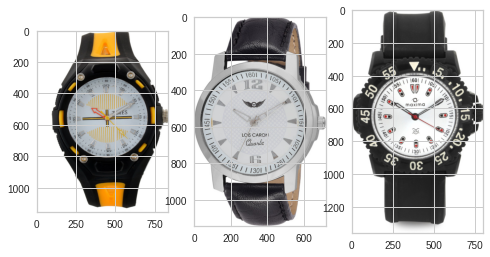

Kitchen & Dining
-------


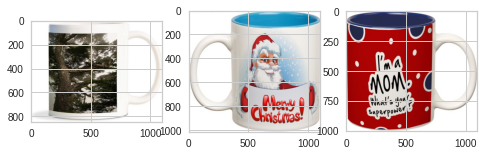

Baby Care
-------


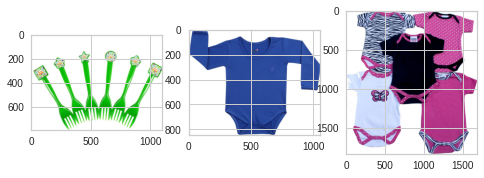

Home Furnishing
-------


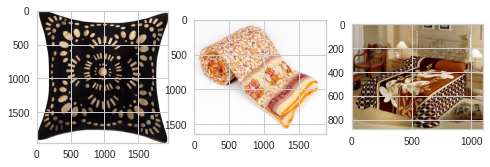

Home Decor & Festive Needs
-------


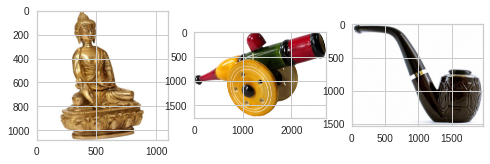

Computers
-------


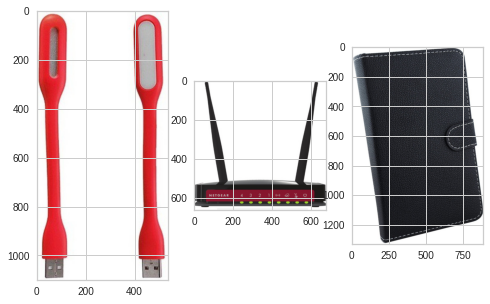

Beauty and Personal Care
-------


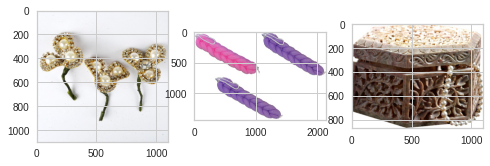

In [251]:
import cv2
print(cv2.__version__)
for name in data_img_final['cat_lvl_1'].value_counts().index :
    print(name)
    print("-------")
    for i in range(3):
        plt.subplot(130 + 1 + i)
        filename = path + list_fct(name)[i+10]
        image = imread(filename)
        plt.imshow(image)
    plt.show()

Maintenant que nous avons réussi à afficher quelques images selon les catégories , nous allons passer à la transformation en choisissant une image teste

### Affichage d'exemple et Transformation 

In [252]:
data_img_final[data_img_final['image_path'] =='e6b483fce5fd910afda67d97dc04e775.jpg']

,image_path,cat_lvl_1,label
994,e6b483fce5fd910afda67d97dc04e775.jpg,Home Furnishing,4


In [253]:
# Choisissons une image 
data_img_final['image_path'][994]

'e6b483fce5fd910afda67d97dc04e775.jpg'

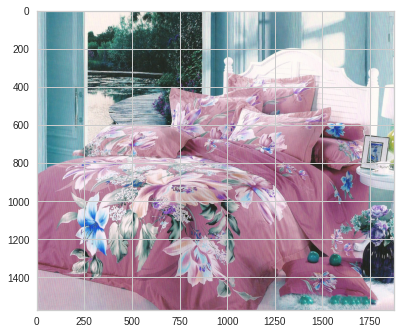

In [254]:
file = path + data_img_final["image_path"][994]
img_test = cv2.imread(file)
plt.imshow(img_test)

Nous pouvons récupérer la taille de l'image en pixel

In [255]:
# Récupérer et afficher la taille de l'image (en pixels)
print("Taille de la matrice de pixels : {} px".format(img_test.shape))

Taille de la matrice de pixels : (1571, 1880, 3) px


Nous pouvons également récupérer d'un seul coup les valeurs de tous les pixels de l'image à l'aide de la bibliothèque numpy.

In [256]:
import numpy as np

# Récupérer les valeurs de tous les pixels sous forme d'une matrice
mat = np.array(img_test)
print(mat)

# Afficher la taille de la matrice de pixels
print("Taille de la matrice de pixels : {} px ".format(mat.shape))

[[[195 207 211]
  [188 203 206]
  [190 206 212]
  ...
  [198 213 216]
  [199 211 217]
  [200 212 218]]

 [[187 199 203]
  [183 198 201]
  [188 204 210]
  ...
  [202 217 220]
  [204 216 222]
  [206 218 224]]

 [[191 203 207]
  [186 201 204]
  [189 205 211]
  ...
  [203 218 221]
  [204 218 224]
  [205 219 225]]

 ...

 [[206 187 204]
  [200 181 196]
  [204 185 202]
  ...
  [218 203 211]
  [211 198 206]
  [217 205 211]]

 [[210 192 209]
  [202 184 201]
  [203 185 202]
  ...
  [221 206 214]
  [211 199 205]
  [214 202 208]]

 [[214 196 213]
  [205 187 204]
  [204 186 203]
  ...
  [218 203 211]
  [213 201 207]
  [220 208 214]]]
Taille de la matrice de pixels : (1571, 1880, 3) px 


### Manipulation d'histogramme

Nous abordons ici les techniques de traitement d'images basées sur la modification d'histogrammes. Ces méthodes font partie de la classe des traitements dits ponctuels : la valeur de chaque pixel est corrigée, et ce indépendamment des autres pixels.

Histogramme d'une image numérique est une courbe statistique représentant la répartition de ses pixels selon leur intensité. Pour une image en noir et blanc, il indique en abscisse le niveau de gris (entier entre 0 et 255) et en ordonnée, le nombre de pixels ayant cette valeur.

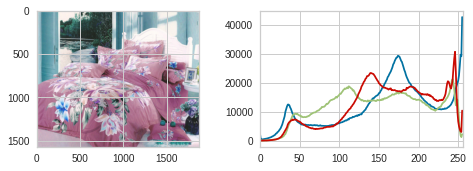

In [257]:
# Calculate histogram without mask
plt.figure()
hist1 = cv2.calcHist([img_test],[0],None,[256],[0,256])
hist2 = cv2.calcHist([img_test],[1],None,[256],[0,256])
hist3 = cv2.calcHist([img_test],[2],None,[256],[0,256])

plt.subplot(221), plt.imshow(img_test)
plt.subplot(222), plt.plot(hist1), plt.plot(hist2),plt.plot(hist3)
plt.xlim([0,256])

plt.show()

Vous pouvez voir cette documentation sur les histogrammes des codes ci-dessus https://docs.opencv.org/4.x/d1/db7/tutorial_py_histogram_begins.html

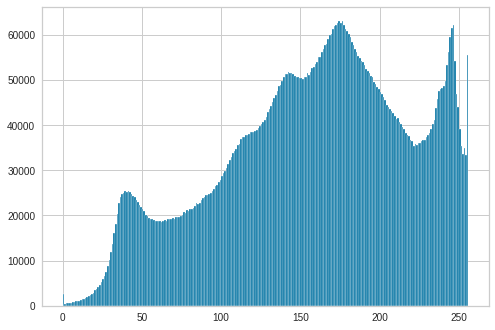

In [258]:
img_test = cv2.imread(file)
plt.hist(img_test.ravel(),256,[0,256]); plt.show()

Nous pouvons utiliser le tracé normal de matplotlib, ce qui serait bon pour le tracé RGB. Pour cela, vous devez d'abord trouver les données de l'histogramme avec les codes qu'on a essayé ci-dessus :

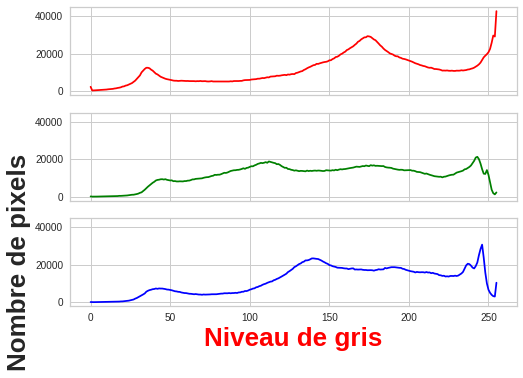

In [259]:
fig,ax=plt.subplots(3,1,sharex=True,sharey=True)
ax[0].plot(hist1,color='red')
ax[1].plot(hist2,color='green')
ax[2].plot(hist3,color='blue')
plt.ylabel('Nombre de pixels',fontsize=26, fontweight = 'bold')
plt.xlabel('Niveau de gris',fontsize = 26, fontweight = 'bold', color="red")

#plt.title('Couleur rouge', fontsize = 30, fontweight = 'bold')
plt.show()

Nous avons utilisé cv.calcHist() pour trouver l'histogramme de l'image complète.

On peut en déduire du graphe ci dessus que les trois couleurs ont la même valeur dans l'image.

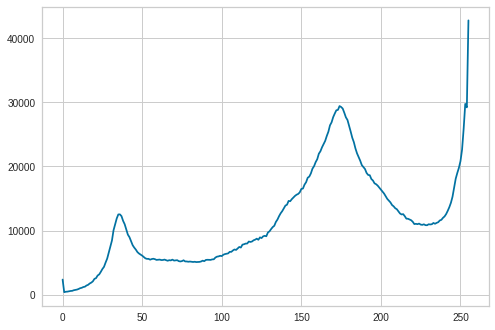

In [260]:
# Visualisation de la première histogramme(bleue)
plt.plot(hist1)

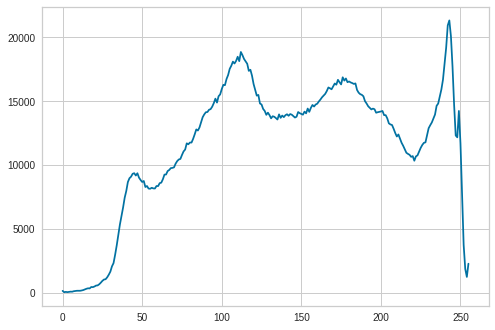

In [261]:
# Visualisation de la deuxième histogramme(vert)
plt.plot(hist2)

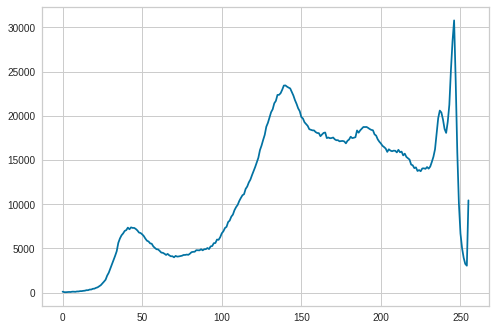

In [262]:
# Visualisation de la troisième histogramme(rouge)
plt.plot(hist3)

### Passage en Noir et Blanc (niveaux de gris)

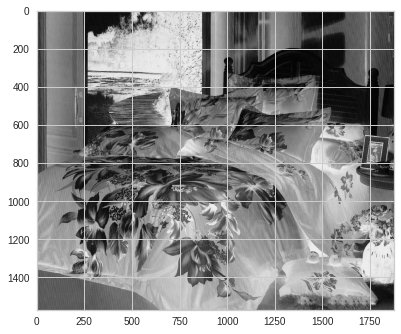

In [263]:
# Conversion d'espace colorimétrique avec color
from skimage import color
# Lecture, sauvegarde et affichage d'images avec io
from skimage import io
img = io.imread(file)
imgGray = color.rgb2gray(img)
plt.imshow(imgGray)

1880 1571
-----------------
470 392


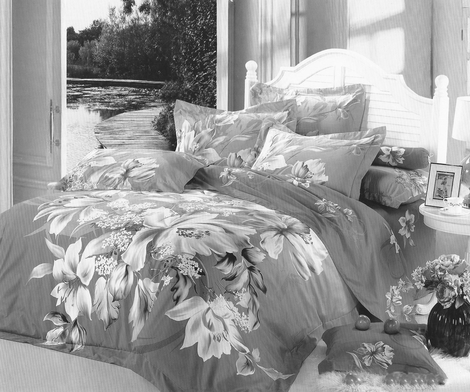

In [264]:
from PIL import Image

# Charger l'image
img = Image.open(file)
# Convertir l'image d'origine en niveaux de gris
img_Convert = img.convert('L') # avec L pixels 8 bits, noir et blanc
img_Convert
# Afficher la largeur et hauteur initiale de l'image 
print(img_Convert.width,img_Convert.height)
print("-----------------")
img_Convert = img_Convert.resize((int(img_Convert.width/4),int(img_Convert.height/4)),resample = Image.LANCZOS)
# Afficher l'image chargée aprés convertion des dimensions
print(img_Convert.width,img_Convert.height)
img_Convert

No handles with labels found to put in legend.


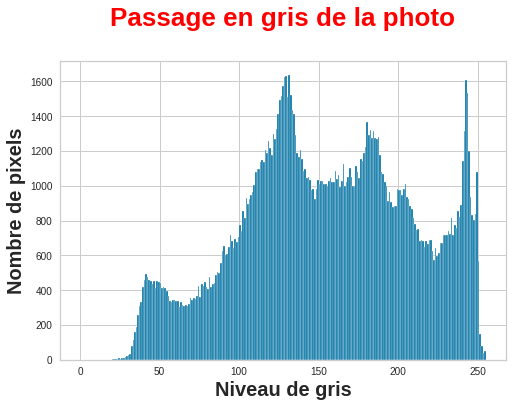

In [265]:
# L'histogramme
img = np.array(img_Convert)
n, bins, patches = plt.hist(img.flatten(), bins=range(256))
plt.ylabel('Nombre de pixels',fontsize = 20, fontweight = 'bold')
plt.xlabel('Niveau de gris',fontsize = 20, fontweight = 'bold')
plt.title('Passage en gris de la photo', fontsize = 26, pad = 35, fontweight = 'bold',color="red")
plt.legend()
plt.show()

Passons à la pratique,avant de commencer à coder, il faut choisir une image de test en noir et blanc.

Par exemple, les niveaux de gris concernent uniquement les entiers compris entre 0 (noir) et 255 (blanc), et les couleurs dans le modèle RGB sont déterminées par un triplet de niveaux de gris (rouge : (255,0,0), vert : (0,255,0) et bleu : (0,0,255)).

### Autre methode passage en gris

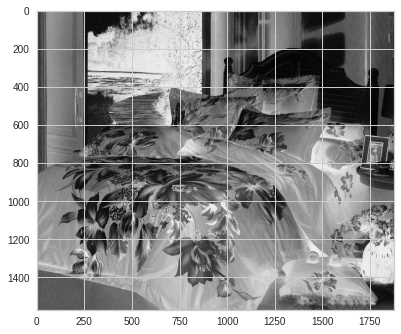

In [266]:
# Afficher l'image en noir et blanc 
new_img = cv2.imread(file,0)  # avec le 0 = passage en gris
plt.imshow(new_img)

Visualisons l'histogramme de l'image ci-dessus

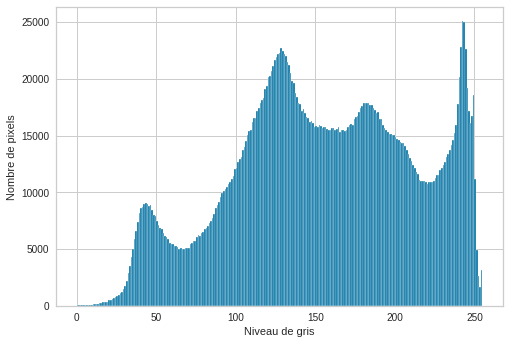

In [267]:
# Visualisation avec l'histogramme
n, bins, patches = plt.hist(new_img.flatten(), bins=range(256))
plt.ylabel('Nombre de pixels')
plt.xlabel('Niveau de gris')
plt.show()

Voici l'histogramme de notre image en noir et blanc avec trop de contraste.

Comme vous pouvez le constater, les pixels des images dont le contraste est mauvais se répartissent dans tout l'intervalle disponible – donc un étirement d'histogramme n'améliorera rien mais pas de manière équitable.

## Élimination du bruit (filtrage d'images)

En traitement d'images, un noyau de convolution est une matrice 2D utilisée pour filtrer les images.
Le filtrage d'une image source est réalisé en faisant convoluer le noyau avec l'image. En termes simples, la convolution d'une image avec un noyau représente une opération mathématique simple, entre le noyau et ses éléments correspondants dans l'image.

Nous allons utiliser la filter2D()fonction dans OpenCV pour appliquer l'opération de filtrage sur l'image source. 
https://learnopencv.com/image-filtering-using-convolution-in-opencv/

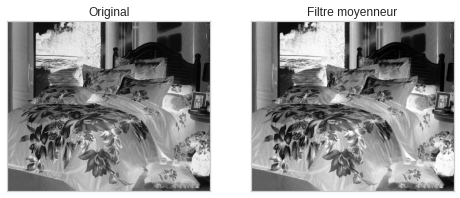

In [268]:
#conversion en tableau array
kernel=np.ones((5,5),np.float32)/25
# convertir en gris
new_img = cv2.imread(file,0)
#filtrage moyenne
dst = cv2.filter2D(new_img,-1,kernel) 
# Visualisation
plt.subplot(121),plt.imshow(new_img),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(dst),plt.title('Filtre moyenneur')
plt.xticks([]), plt.yticks([])
plt.show()

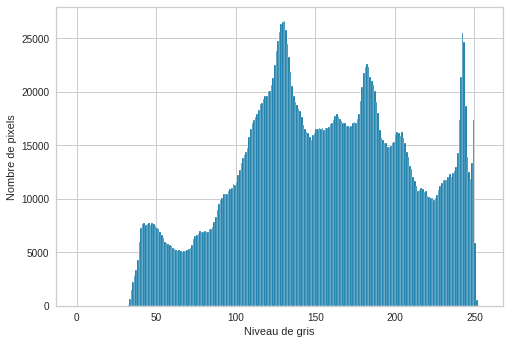

In [269]:
# Histogramme aprés élimination du bruit
n, bins, patches = plt.hist(dst.flatten(), bins=range(256))
plt.ylabel('Nombre de pixels')
plt.xlabel('Niveau de gris')
plt.show()

## Egalisation d’histogrammes

La deuxième application courante concerne l'amélioration du contraste de l'image.

Le contraste caractérise la répartition de lumière dans une image : plus une image est contrastée, plus la différence de luminosité entre ses zones claires et sombres est importante

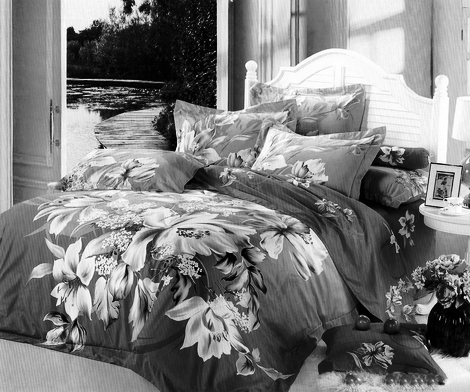

In [270]:
# Egalisation histogramme pour l'amelioration du contraste 
from PIL import ImageOps
img_egal=ImageOps.equalize(img_Convert)
img_egal

Notre image peu contrastée après égalisation et son histogramme ci-dessous

No handles with labels found to put in legend.


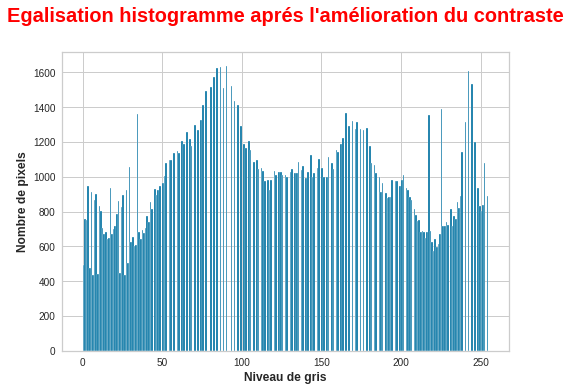

In [271]:
# Visualisation de l'histogramme
t = np.array(img_egal)
n, bins, patches = plt.hist(t.flatten(), bins=range(256))
plt.ylabel('Nombre de pixels',fontsize = 12, fontweight = 'bold')
plt.xlabel('Niveau de gris',fontsize = 12, fontweight = 'bold')
plt.title('Egalisation histogramme aprés l\'amélioration du contraste', fontsize = 20, pad = 30, fontweight = 'bold',color="red")
plt.legend()
plt.show()

L'image est plus contrastée et son histogramme confirme que la distribution de ses niveaux de gris est plus uniforme.

En pratique, les histogrammes après égalisation ne sont pas parfaitement plats, comme le montre l'exemple précédent. Cela est dû au fait que les intensités des pixels sont discrètes.
https://docs.opencv.org/3.4/d4/d1b/tutorial_histogram_equalization.html

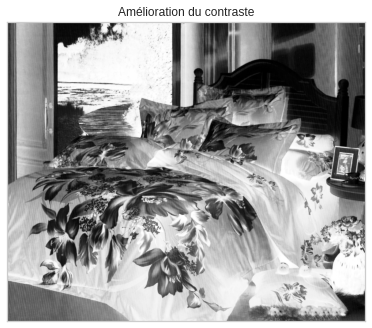

In [272]:
# Appliquer l'égalisation d'histogramme avec la fonction cv::equalizeHist 
img_egalise = cv2.equalizeHist(dst)
plt.imshow(img_egalise),plt.title('Amélioration du contraste')
plt.xticks([]), plt.yticks([])
plt.show()

# Technique d'appariement d'images 

## Détermination et affichage des descripteurs SIFT 

In [273]:
import cv2
cv2.__version__

'4.1.2'

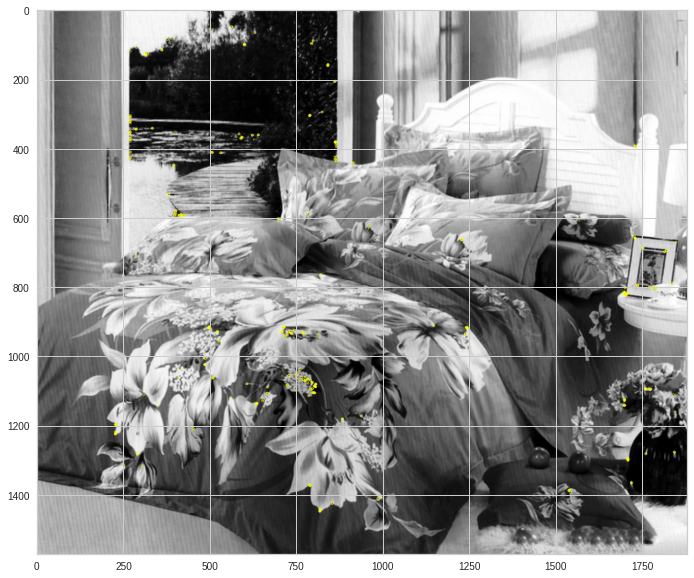

Descripteurs :  (500, 32)

[[ 26  30 174 ... 228  53  82]
 [ 31 102 226 ... 159 249 229]
 [233  97 248 ... 189  94 226]
 ...
 [131 217  21 ...   8 129 253]
 [ 64 232 184 ...   0 167  42]
 [189  76  87 ... 187 120  32]]


In [274]:
import cv2
from PIL import Image
sift = cv2.ORB_create()
#sift=cv2.SIFT_create()
image = cv2.imread(file,0) 
# transformation en tableau d'array
#et passage en gris 
#image=Image.open(path+data4['image_path'][i][946])
kernel=np.ones((5,5),np.float32)/25
dst = cv2.filter2D(image,-1,kernel) #filtrage par moyenne
image1 = cv2.equalizeHist(dst)   # equalize image histogram
kp, des = sift.detectAndCompute(image1, None)
img=cv2.drawKeypoints(image1,kp,image1,color=(255, 255, 0))
plt.figure(figsize=(20,10))
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)

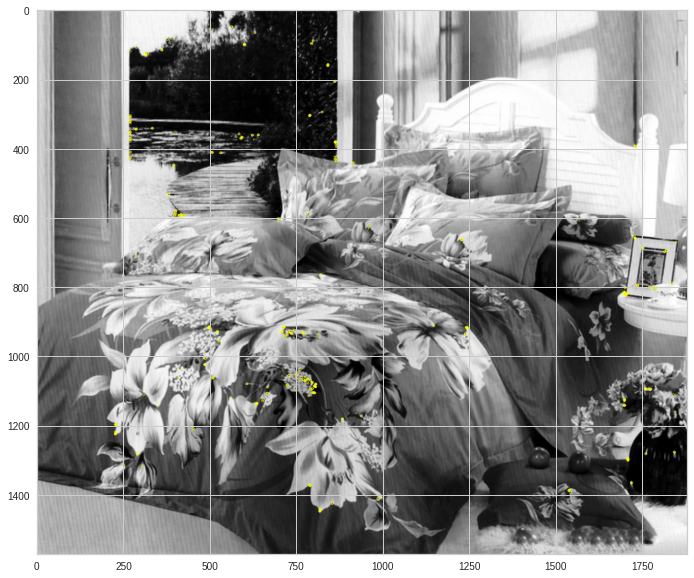

Descripteurs :  (500, 32)

[[ 26  30 174 ... 228  53  82]
 [ 31 102 226 ... 159 249 229]
 [233  97 248 ... 189  94 226]
 ...
 [131 217  21 ...   8 129 253]
 [ 64 232 184 ...   0 167  42]
 [189  76  87 ... 187 120  32]]


In [275]:
from PIL import Image
sift = cv2.ORB_create()
#sift=cv2.SIFT_create()
new_img = cv2.imread(file,0) 
# transformation en tableau d'array
#et passage en gris 
kernel=np.ones((5,5),np.float32)/25

#filtrage par moyenne
dst = cv2.filter2D(image,-1,kernel) 

# equalize image histogram
img1 = cv2.equalizeHist(dst) 

#  Recherche les points clés et les descripteurs en une seule étape 
kp, des = sift.detectAndCompute(img1, None)

# dessine uniquement l'emplacement des points clés, pas la taille et l'orientation
img=cv2.drawKeypoints(img1,kp,img1,color=(255, 255, 0))

#Visualisation
plt.figure(figsize=(20,10))
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)

Nous avons 500 descripteurs et chaque descripteur est un vecteur de longeur 32. 

Un descripteur est un vecteur qui décrit le voisinage de la feature à laquelle il est associé.Il est utilisé pour repérer les paires de features qui se ressemblent le plus dans deux images.

Les features désignent des zones intéressantes de l'image numérique. Ces zones peuvent correspondre à des contours, des points ou des régions d'intérêt. A chaque feature détectée est associé un vecteur, appelé descripteur (feature descriptor ou feature vector), qui, comme son nom l'indique, décrit la zone concernée.
https://docs.opencv.org/3.4/d1/d89/tutorial_py_orb.html

https://docs.opencv.org/3.4/da/df5/tutorial_py_sift_intro.html

# Pré-traitement des images via SIFT

## Créations des descripteurs de chaque image

* Pour chaque image suppression du bruit et egalisation

* création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par   image

* création d'une liste de descripteurs pour l'ensemble des images ("sift_keypoints_all") qui sera utilisé pour créer les     clusters de descripteurs

In [276]:
import time
sift_keypoints = []
temps1=time.time()
sift = cv2.ORB_create()
for img_num in range(len(list_photos)) :
    # Convertir en gris
    new_img = cv2.imread(file,0) 
    
    # transformation en tableau numpy
    kernel=np.ones((5,5),np.float32)/25
    
    #filtrage par moyenn
    dst = cv2.filter2D(new_img,-1,kernel) 
    
    # equalize image histogram
    res = cv2.equalizeHist(dst)  
    
    # trouver les points clés avec ORB
    # calcule les descripteurs avec ORB
    kp, des = sift.detectAndCompute(res, None)
    sift_keypoints.append(des)

sift_keypoints_by_img = np.asarray(sift_keypoints)
sift_keypoints_all    = np.concatenate(sift_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

duration1=time.time()-temps1
print("Temps de traitement SIFT descriptEUR : ", "%15.2f" % duration1, "secondes")


Nombre de descripteurs :  (525000, 32)
Temps de traitement SIFT descriptEUR :           143.22 secondes


Nous avons en tout 525000 descripteurs avec une longeur 32

## Création des clusters de descripteurs 

* Utilisation de MiniBatchKMeans pour obtenir des temps de traitement raisonnables

Pour le nombre de clusters on a deux méthodes Nombre de cluster = racine carré (nombre de descripteurs) ou Nombre de cluster= le nombre de catégorie qu'on veut trouver *10. Nous allons regrouper les descripteurs qui se ressemblent le plus on appelle bag of features

In [277]:
from sklearn import cluster, metrics

# Détermination du nombre de grappes
temps1=time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_keypoints_all)
#init_size c'est le nombre d'échantillon à échantilloner aléatoirement
#pour accélérer l'initialisation


duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  725
Création de 725 clusters de descripteurs ...
temps de traitement kmeans :            10.09 secondes


## Création des features des images (bag of features)
* Pour chaque image :

    - prédiction des numéros de cluster de chaque descripteur
    
    - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image
    
Nous avons 725 clusters pour chaque image on va compter le nombre de regroupement de descripteur chaque cluster de descripteur est l'équivalent d'un mot on va prendre chaque image et on regarde s'il ya ce regroupement de descripteur Ces clusters deront nos features

Features d'une image = Histogramme d'une image = Comptage pour une image du nombre de descripteurs par cluster    

In [278]:
# Creation of histograms (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Création d'une matrice d'histogrammes
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :             3.37 secondes


In [279]:
# Liste des descripteurs de chaque image
print(sift_keypoints_by_img.shape)

# Longueur de la matrice
print(len(hist_vectors))

#nous avons 1050 lignes images et 725 colonnes 
#qui représentent nos bag of visuals
print(im_features.shape) 

(1050, 500, 32)
1050
(1050, 725)


## Réductions de dimension

###  Réduction de dimension PCA

* La réduction PCA permet de créer des features décorrélées entre elles, tout en gardant le maximum d'information
* L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE

In [280]:
X = im_features
# Modèle PCA
pca = PCA(n_components=0.99)
# Entrainer le modèle
data_pca = pca.fit(X)
# Différents composantes
pcs = pca.components_

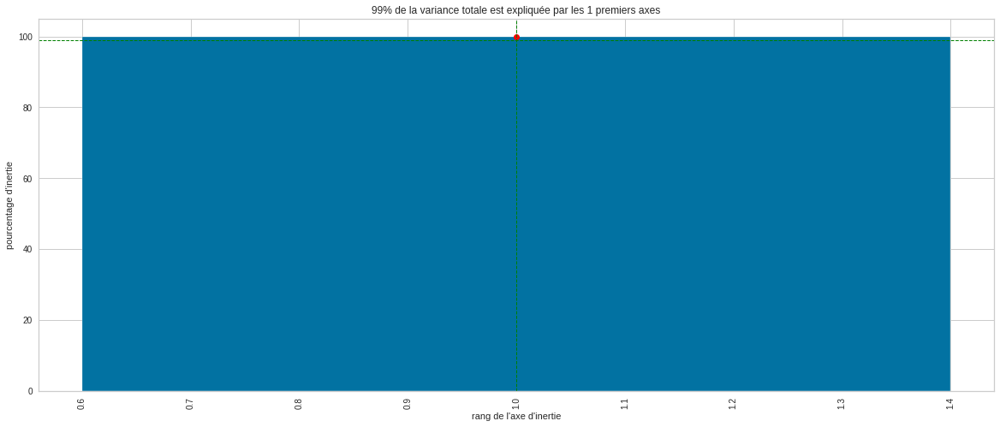

In [281]:
# Variance expliquée
varexpl = pca.explained_variance_ratio_*100

# Graphique de la variance cumulée
plt.figure(figsize=(20,8))
plt.bar(np.arange(len(varexpl))+1, varexpl)

# Somme des variances
cumSumVar = varexpl.cumsum()
plt.plot(np.arange(len(varexpl))+1, cumSumVar, c = "red",marker = 'o')
plt.axhline(y = 99, linestyle="--", color="green",linewidth=1)

limit = 99
valid_idx = np.where(cumSumVar >= limit)[0]
min_plans = valid_idx[cumSumVar[valid_idx].argmin()]+1
plt.axvline(x=min_plans, linestyle="--", 
            color="green",
            linewidth=1)

plt.xticks(rotation=90)
plt.xlabel("rang de l'axe d'inertie")
#plt.xticks(np.arange(len(varexpl))+1)
plt.ylabel("pourcentage d'inertie")
plt.title("{}% de la variance totale est expliquée"\
          " par les {} premiers axes".format(limit,
                                            min_plans))
plt.show(block=False)

In [282]:
sum_pca = np.cumsum(pca.explained_variance_ratio_)
for counter, value in enumerate(sum_pca):
    if value > 0.9:
        X_reduced = pca.transform(X)[:,:counter]
        break

In [283]:
X_reduced.shape

(1050, 0)

In [284]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_features.shape)

# Instanciation du modèle
pca = decomposition.PCA(n_components=0.99)
# Transformé les données
feat_pca = pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 725)
Dimensions dataset après réduction PCA :  (1050, 1)


### Réduction de dimension T-SNE

* Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images

In [285]:
from sklearn import manifold, decomposition

tsne = manifold.TSNE(n_components=2, perplexity=5, init='random')
X_tsne = tsne.fit_transform(feat_pca)

data_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
data_tsne["class"] = data_nlp["cat_lvl_1"]
print(data_tsne.shape)

(1050, 3)


In [286]:
# Afficher notre dataset data_tsne
data_tsne.head(5)

,tsne1,tsne2,class
0,-2.524947,1.322539,Home Furnishing
1,-0.763275,-1.310269,Baby Care
2,-0.796745,-1.310297,Baby Care
3,-0.801436,-1.286119,Home Furnishing
4,-0.798359,-1.310151,Home Furnishing


##  Visualisation T-SNE selon les catégories et les clusters

### 15.6.1  Création de clusters à partir des catégories de produits

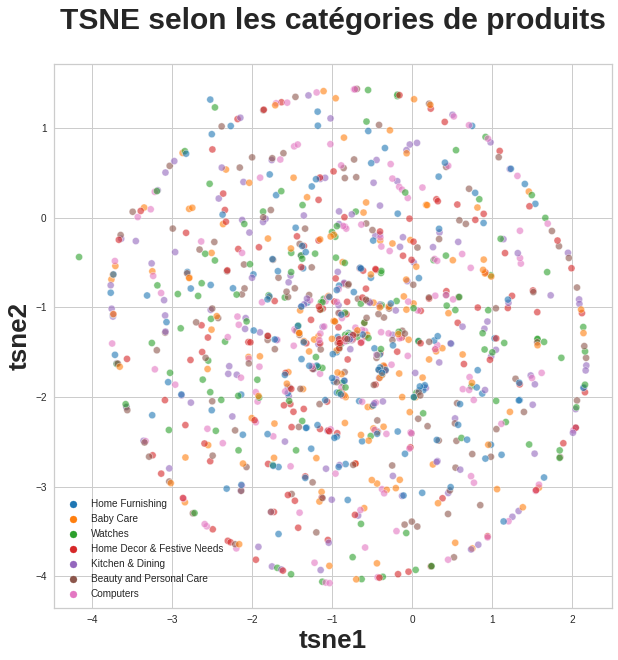

In [287]:
# Visualisation
plt.figure(figsize=(10,10))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=data_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les catégories de produits', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend() 
plt.show()

On voit qu'il ya aucun groupe de catégories de produits qui se distinguent , ils sont tous mélangés. On va essayer de conforter cette analyse visuelle par une mesure de similarite entre catégories et clusters.

### Création de clusters à partir du T-SNE

In [288]:
data_tsne

,tsne1,tsne2,class
0,-2.524947,1.322539,Home Furnishing
1,-0.763275,-1.310269,Baby Care
2,-0.796745,-1.310297,Baby Care
3,-0.801436,-1.286119,Home Furnishing
4,-0.798359,-1.310151,Home Furnishing
...,...,...,...
1045,0.320291,-3.186731,Baby Care
1046,0.184089,0.143732,Baby Care
1047,-1.037044,-3.886352,Baby Care
1048,-1.004453,-1.349929,Baby Care


In [289]:
from sklearn import cluster, metrics

# Instanciation du modèle
cls = cluster.KMeans(n_clusters=7, random_state=6)
# Entrainer le modèle
cls.fit(X_tsne)

# Labels
data_tsne["cluster"] = cls.labels_
print(data_tsne.shape)

(1050, 4)


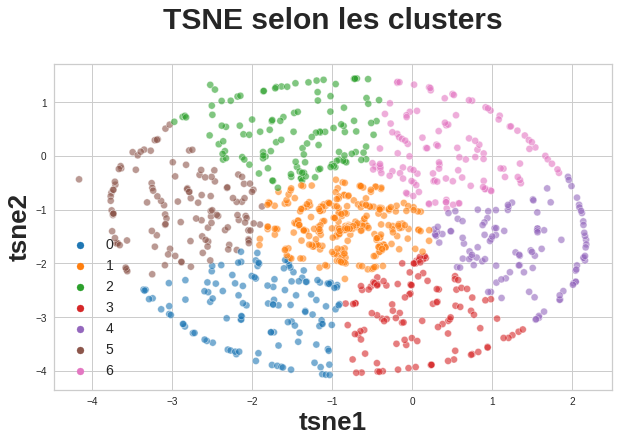

In [290]:
# Visualisation
plt.figure(figsize=(10,6))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,
    data=data_tsne,
    legend="brief")

plt.title('TSNE selon les clusters', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend(prop={'size': 14}) 

plt.show()

## Analyse mesures : similarité entre catégories et clusters

In [291]:
# Noms des colonnes 
colnames = list(data_img_final.columns)
colnames

['image_path', 'cat_lvl_1', 'label']

In [292]:
# Noms des colonnes 
colnames = list(data_tsne.columns)
colnames

['tsne1', 'tsne2', 'class', 'cluster']

###  Affichage des images selon clusters et calcul ARI de similarité catégories images / clusters

In [293]:
# Afficher les 5 premières lignes
data_img_final[["label","cat_lvl_1"]].head(5)

,label,cat_lvl_1
0,6,Watches
1,5,Kitchen & Dining
2,5,Kitchen & Dining
3,0,Baby Care
4,4,Home Furnishing


In [294]:
print(data_img_final.shape)
print(data_tsne.shape)

(1050, 3)
(1050, 4)


In [295]:
from sklearn.metrics import precision_score,accuracy_score,recall_score,confusion_matrix

labels = data_img_final["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

ARI :  0.002781959156602132


Avec cette faible valeur de ARI(très faible devant 1) , on peut dire que le nombre de cluster qu'on ne correspond pas aux catégories de produits qu'on a.

Le nombre de clusters et de catégories de produits sont indépendants.

### Analyse par classes (matrice de confusion)

In [296]:
data_tsne['class'].value_counts()

Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: class, dtype: int64

In [297]:
data_tsne.groupby('cluster').count()['class']

cluster
0    129
1    317
2    123
3    117
4    113
5    127
6    124
Name: class, dtype: int64

In [298]:
# Les labels
print(cls.labels_)

# Les différentes modalités
print(labels.unique())

# l'acuracy
print(accuracy_score(labels,cls.labels_))

[2 1 1 ... 0 1 5]
[6 5 0 4 3 2 1]
0.14095238095238094


In [299]:
conf_mat = metrics.confusion_matrix(labels, cls.labels_)
#labels vraie valeurs
#cls.labels_ les cluster du tsne
l=cls.labels_
g=data_img_final['cat_lvl_1'].value_counts().index
print(conf_mat)

[[21 41 24 16 22 12 14]
 [20 34 18 27 15 11 25]
 [24 43 20 16  7 25 15]
 [20 50 15 12 14 20 19]
 [14 55 15 14 21 21 10]
 [15 53 13 16 12 20 21]
 [15 41 18 16 22 18 20]]


In [300]:
corresp = np.argmax(conf_mat,axis=0)
corresp

array([2, 4, 0, 1, 0, 2, 1])

In [301]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    #corresp = np.argmax(conf_mat,axis=0) vu quon a un numero de colonne de
    #la valeur max les meme pour deux lignes on le fait manuellement
    #on na pas des accuracy proche de 1 on pouvait utiliser le argmax
    corresp = [0, 3, 6, 4, 2, 1, 5]
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

cls_labels_transform = conf_mat_transform(labels, cls.labels_)
conf_mat = metrics.confusion_matrix(labels, cls_labels_transform)
print(conf_mat)
print()
print(metrics.classification_report(labels, cls_labels_transform))
#accuracy =precision la plus part sont prédits positifs et le sont effectivement
#recall=sensibilte taux de vrais positifs 
#specifite =taux de varais negatifs

Correspondance des clusters :  [0, 3, 6, 4, 2, 1, 5]
[[21 12 22 41 16 14 24]
 [20 11 15 34 27 25 18]
 [24 25  7 43 16 15 20]
 [20 20 14 50 12 19 15]
 [14 21 21 55 14 10 15]
 [15 20 12 53 16 21 13]
 [15 18 22 41 16 20 18]]

              precision    recall  f1-score   support

           0       0.16      0.14      0.15       150
           1       0.09      0.07      0.08       150
           2       0.06      0.05      0.05       150
           3       0.16      0.33      0.21       150
           4       0.12      0.09      0.10       150
           5       0.17      0.14      0.15       150
           6       0.15      0.12      0.13       150

    accuracy                           0.14      1050
   macro avg       0.13      0.14      0.13      1050
weighted avg       0.13      0.14      0.13      1050



In [302]:
column = [i for i in data_tsne['cluster'].value_counts().index]
print(column)

[1, 0, 5, 6, 2, 3, 4]


In [303]:
indice=[label for label in data_tsne['class'].value_counts().index]
print(indice)

['Home Furnishing', 'Baby Care', 'Watches', 'Home Decor & Festive Needs', 'Kitchen & Dining', 'Beauty and Personal Care', 'Computers']


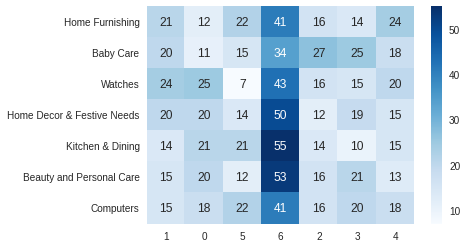

In [304]:
table = pd.DataFrame(conf_mat, index = indice, columns = column)
plt.figure(figsize = (6,4))
sns.heatmap(table, annot=True, cmap="Blues")

In [305]:
# Afficher le DataFrame
table

,1,0,5,6,2,3,4
Home Furnishing,21,12,22,41,16,14,24
Baby Care,20,11,15,34,27,25,18
Watches,24,25,7,43,16,15,20
Home Decor & Festive Needs,20,20,14,50,12,19,15
Kitchen & Dining,14,21,21,55,14,10,15
Beauty and Personal Care,15,20,12,53,16,21,13
Computers,15,18,22,41,16,20,18


En conclusion la methode ORB donne des mauvais resultats pour la classification dimages nous pouvons utiliser d'autres techniques plus puissant comme le CNN transfert learning du deep learning. On a du mal à distinguer d'autres classes ce qui nous pousse à réfléchir sur d'autres techniques. Comme le transfert learning

# Assemblage données textuelles et visuelles

In [306]:
# Données textuelle avec binary
count_vect.shape
print(count_vect.values)

[[0 0 0 ... 0 0 1]
 [0 0 0 ... 0 0 6]
 [0 0 0 ... 0 0 1]
 ...
 [0 0 0 ... 0 0 3]
 [0 0 0 ... 0 0 3]
 [0 0 0 ... 0 0 3]]


In [307]:
# Données visuelles
im_features.shape
print(im_features)

[[0.004 0.002 0.002 ... 0.002 0.    0.   ]
 [0.004 0.002 0.002 ... 0.002 0.    0.   ]
 [0.004 0.002 0.002 ... 0.002 0.    0.   ]
 ...
 [0.004 0.002 0.002 ... 0.002 0.    0.   ]
 [0.004 0.002 0.002 ... 0.002 0.    0.   ]
 [0.004 0.002 0.002 ... 0.002 0.    0.   ]]


In [308]:
# Concaténation des deux jeux de données
img_corpus = np.concatenate((im_features,count_vect.values),axis=1)
print(img_corpus.shape)

(1050, 894)


## Réduction de dimension PCA

In [309]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", img_corpus.shape)

# Instanciation du modèle
pca = decomposition.PCA(n_components=0.99)
# Transformé les données
feat_pca = pca.fit_transform(img_corpus)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 894)
Dimensions dataset après réduction PCA :  (1050, 91)


## Réduction de dimension T-SNE

In [310]:
from sklearn import manifold, decomposition

tsne = manifold.TSNE(n_components=2, perplexity=5, init='random')
X_tsne = tsne.fit_transform(feat_pca)

data_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
data_tsne["class"] = data_img_final["cat_lvl_1"]
print(data_tsne.shape)

(1050, 3)


## Visualisation T-SNE selon les catégories et les clusters

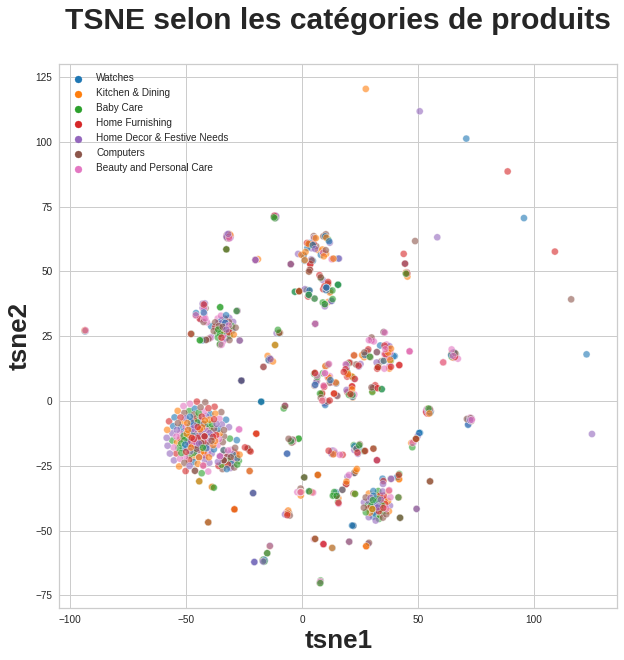

In [311]:
# Visualisation
plt.figure(figsize=(10,10))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=data_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les catégories de produits', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend() 
plt.show()

In [312]:

import os
import zipfile
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from glob import glob

from tqdm import tqdm_notebook
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Input, Lambda, Dense, Flatten
from keras.models import load_model, Model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

%matplotlib inline
tf.__version__

'2.8.0'

In [313]:
from sklearn.model_selection import train_test_split

In [314]:
data_final = data_img_final.copy()
data_final.head(2)

,image_path,cat_lvl_1,label
0,0dc4d2767fe8424a3263ab141884f83d.jpg,Watches,6
1,0d3e1dc0d38be59e9927e47f152e48aa.jpg,Kitchen & Dining,5


In [315]:
x = data_final["image_path"]
y = data_final["label"]

In [316]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state= 42)
print("x_train shape:", x_train.shape)
print("x_test shape:", x_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

x_train shape: (840,)
x_test shape: (210,)
y_train shape: (840,)
y_test shape: (210,)


In [317]:
from tensorflow.keras.utils import to_categorical

#One Hot Encoding
#One Hot Encoding 
y_train=to_categorical(y_train) 
y_test=to_categorical(y_test)

In [318]:
#Vérification de la dimension après un encodage à chaud 
print((x_train.shape,y_train.shape)) 
print((x_test.shape,y_test.shape))

((840,), (840, 7))
((210,), (210, 7))


In [319]:
print(type(x_train))
print(type(x_test))
print(type(y_train))
print(type(y_test))

<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
